## Rosemann Sales Forecasting

https://www.kaggle.com/competitions/rossmann-store-sales/data

#### **Data:**
We have historical sales data for 1,115 Rossmann stores.

1. Train Data
 * **Sales**: the turnover for any given day (target variable).
 * **Customers**: the number of customers on a given day.
 * **Open**: an indicator for whether the store was open: 0 = closed, 1 = open.
 * **Promo**: indicates whether a store is running a promo on that day.
 * **Promo2** : Promo2 is a continuing and consecutive promotion for some stores: 0 = store is not participating, 1 = store is participating
 * **StateHoliday**: indicates a state holiday. Normally all stores, with few exceptions, are closed on state holidays.Note that all schools are closed on public holidays and weekends. a = public holiday, b = Easter holiday, c = Christmas, 0 = None
 * **SchoolHoliday**: indicates if the (Store, Date) was affected by the closure of public schools.
2. Store Data
 * **Store:** unique Id for each store
 * **StoreType** - differentiates between 4 different store models: a, b, c, d
 * **Assortment** - describes an assortment level: a = basic, b = extra, c = extended
 * **CompetitionDistance** - distance in meters to the nearest competitor store
 * **CompetitionOpenSince[Month/Year]** - gives the approximate year and month of the time the nearest competitor was opened
 * **PromoInterval** - describes the consecutive intervals Promo2 is started, naming the months the promotion is started anew. E.g. "Feb,May,Aug,Nov" means each round starts in February, May, August, November of any given year for that store

#### **Steps:**
1. **Merging Dataframes**
2. **Handling Missing Values**
3. **Reducing Memory**
4. **Empirical Cumulative Distribution Function(ECDF)**
5. **EDA**
6. **MULTI-COLLINEARITY - VARIANCE INFLATION FACTOR**

In [1]:
# !pip install prophet

In [2]:
# !pip install --upgrade plotly
# !pip install --upgrade notebook

In [3]:
# !pip install --upgrade pip

In [4]:
# !pip install category_encoders

In [5]:
# pip install chart-studio!pip install pmdarima

In [6]:
# !pip install prophet

In [7]:
# GENERAL IMPORTS
import pandas as pd
from pandas.plotting import autocorrelation_plot  # AUTO-CORRELATION PLOT
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
pd.set_option('display.max_columns', None)
plt.style.use('dark_background')

# pd.plotting.register_matplotlib_converters()

# pd.options.plotting.backend = "plotly"
# plt.rcParams['figure.dpi'] = 150
# plt.rcParams['figure.figsize'] = (8,8)

# IMPORTS FROM STATSMODELS
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf # PLOT ACF,PACF
from statsmodels.tsa.stattools import adfuller  # AUGMENTED DICKEY FULLER TEST
from statsmodels.tsa.seasonal import seasonal_decompose # SEASONAL DECOMPOSITION
from statsmodels.distributions.empirical_distribution import ECDF # EMPIRICAL DISTRIBUTION
from statsmodels.stats.outliers_influence import variance_inflation_factor # FOR MULTI-COLLINEARITY
from statsmodels.tsa.arima.model import ARIMA # ARIMA MODEL
from statsmodels.tsa.statespace.sarimax import SARIMAX  # SEASONAL-ARIMA MODEL

from pmdarima.arima import auto_arima  # AUTO-ARIMA MODEL

# IMPORTS FROM PROPHET 
from prophet import Prophet  # FACEBOOK PROPHET MODEL
from prophet.plot import (plot_plotly,plot_components_plotly,
                          plot_forecast_component_plotly,plot_seasonality_plotly)
from prophet.diagnostics import cross_validation # CROSS-VALIDATION FOR PROPHET MODEL
from prophet.diagnostics import performance_metrics  # PERFORMANCE METRICS FOR CROSS-VALIDATION OF PROPHET
from prophet.plot import plot_cross_validation_metric  # PLOT CROSS VALIDATION METRICS OF PROPHET

# IMPORTING PROPHET
from prophet import Prophet

# CATEGORY ENCODERS --> FOR BINARY FEATURE ENCODING
import category_encoders as ce

# IMPORTS FROM SCIKIT-LEARN
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (mean_absolute_error,mean_squared_error,mean_absolute_percentage_error,
                             r2_score)
from xgboost import XGBRegressor # XGBOOST MODEL


In [8]:
# import plotly.io as pio
# pio.renderers.default = 'notebook'

In [9]:
train_df = pd.read_csv('./Rosemann_Sales_data/train.csv',
                      parse_dates=['Date'])
store_df = pd.read_csv('./Rosemann_Sales_data/store.csv')

/var/folders/yz/rd_p5r694wz4_q5mc3q3wns40000gn/T/ipykernel_1960/2420687972.py:1: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  train_df = pd.read_csv('./Rosemann_Sales_data/train.csv',


In [10]:
train_df

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1
...,...,...,...,...,...,...,...,...,...
1017204,1111,2,2013-01-01,0,0,0,0,a,1
1017205,1112,2,2013-01-01,0,0,0,0,a,1
1017206,1113,2,2013-01-01,0,0,0,0,a,1
1017207,1114,2,2013-01-01,0,0,0,0,a,1


In [11]:
store_df

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
1110,1111,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1111,1112,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
1112,1113,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN
1113,1114,a,c,870.0,NaN,NaN,0,NaN,NaN,NaN


In [12]:
store_df.columns

Index(['Store', 'StoreType', 'Assortment', 'CompetitionDistance',
       'CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2',
       'Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval'],
      dtype='object')

In [13]:
train_df.shape

(1017209, 9)

**Getting Start and End Dates**

In [14]:
train_df['Date'].min() , train_df['Date'].max()

(Timestamp('2013-01-01 00:00:00'), Timestamp('2015-07-31 00:00:00'))

### Checking for NULL Values

In [15]:
train_df.isnull().sum()

Store            0
DayOfWeek        0
Date             0
Sales            0
Customers        0
Open             0
Promo            0
StateHoliday     0
SchoolHoliday    0
dtype: int64

In [16]:
store_df.isnull().sum()

Store                          0
StoreType                      0
Assortment                     0
CompetitionDistance            3
CompetitionOpenSinceMonth    354
CompetitionOpenSinceYear     354
Promo2                         0
Promo2SinceWeek              544
Promo2SinceYear              544
PromoInterval                544
dtype: int64

**Inference:**
* There are only 3 missing values in CompetitionDistance,,they may be missed due to some manual mistakes...So,replace them with median

### Filling Missing Values

In [17]:
store_df['CompetitionDistance'].fillna(value=store_df['CompetitionDistance'].median(),
                                      inplace=True)
store_df.fillna(value=0,inplace=True)

### Merging Dataframes

In [18]:
df = pd.merge(left=train_df,right=store_df,on='Store',how='left')

In [19]:
df

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9.0,2008.0,0,0.0,0.0,0
1,2,5,2015-07-31,6064,625,1,1,0,1,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,5,2015-07-31,8314,821,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,5,2015-07-31,13995,1498,1,1,0,1,c,c,620.0,9.0,2009.0,0,0.0,0.0,0
4,5,5,2015-07-31,4822,559,1,1,0,1,a,a,29910.0,4.0,2015.0,0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017204,1111,2,2013-01-01,0,0,0,0,a,1,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1017205,1112,2,2013-01-01,0,0,0,0,a,1,c,c,1880.0,4.0,2006.0,0,0.0,0.0,0
1017206,1113,2,2013-01-01,0,0,0,0,a,1,a,c,9260.0,0.0,0.0,0,0.0,0.0,0
1017207,1114,2,2013-01-01,0,0,0,0,a,1,a,c,870.0,0.0,0.0,0,0.0,0.0,0


### Memory Usage

In [20]:
initial_mem = df.memory_usage(deep=True).sum()

In [21]:
print('\033[1m'+'Dataframe is taking ',340529170 / (1024 ** 2),' MB')

Dataframe is taking  324.7539234161377  MB


In [22]:
# CHEKING DTYPES

df.dtypes

Store                                 int64
DayOfWeek                             int64
Date                         datetime64[ns]
Sales                                 int64
Customers                             int64
Open                                  int64
Promo                                 int64
StateHoliday                         object
SchoolHoliday                         int64
StoreType                            object
Assortment                           object
CompetitionDistance                 float64
CompetitionOpenSinceMonth           float64
CompetitionOpenSinceYear            float64
Promo2                                int64
Promo2SinceWeek                     float64
Promo2SinceYear                     float64
PromoInterval                        object
dtype: object

In [23]:
store_df.dtypes

Store                          int64
StoreType                     object
Assortment                    object
CompetitionDistance          float64
CompetitionOpenSinceMonth    float64
CompetitionOpenSinceYear     float64
Promo2                         int64
Promo2SinceWeek              float64
Promo2SinceYear              float64
PromoInterval                 object
dtype: object

### **Downcasting all int64,float64 columns**

In [24]:
# DOWNCASTING INT VALUES
for col in df.select_dtypes(include=['int64']).columns:
    df[col] = pd.to_numeric(df[col], downcast='integer')

# DOWNCASTING FLOAT VALUES TO FLOAT32
for col in df.select_dtypes(include=['float64']).columns:
    df[col] = pd.to_numeric(df[col], downcast='float')

In [25]:
after_mem1 = df.memory_usage(deep=True).sum()

In [26]:
# LOOKING AT CHANGE IN MEMORY
initial_mem - after_mem1

72221839

In [27]:
72221839 / (1024 ** 2)

68.87611293792725

In [28]:
df.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval'],
      dtype='object')

**Getting Month,Year,Day,WeekOfYear from Date Column**

In [29]:
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day
df['WeekOfYear'] = df['Date'].dt.weekofyear

# GETTING SALES PER CUSTOMER
df['SalesPerCustomer'] = df['Sales'] / df['Customers']

/var/folders/yz/rd_p5r694wz4_q5mc3q3wns40000gn/T/ipykernel_1235/19953534.py:4: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['WeekOfYear'] = df['Date'].dt.weekofyear


### EDA

In [30]:
df.describe().apply(lambda x : round(x,2))

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,Year,Month,Day,WeekOfYear,SalesPerCustomer
count,1017209.00,1017209.0,1017209.00,1017209.00,1017209.00,1017209.00,1017209.00,1017209.00,1017209.00,1017209.00,1017209.0,1017209.00,1017209.00,1017209.00,1017209.00,1017209.00,1017209.00,844340.00
mean,558.43,4.0,5773.82,633.15,0.83,0.38,0.18,5422.02,4.93,1370.17,0.5,11.65,1007.01,2013.83,5.85,15.70,23.62,9.49
std,321.91,2.0,3849.93,464.41,0.38,0.49,0.38,7705.62,4.28,934.34,0.5,15.26,1006.29,0.78,3.33,8.79,14.43,2.20
min,1.00,1.0,0.00,0.00,0.00,0.00,0.00,20.00,0.00,0.00,0.0,0.00,0.00,2013.00,1.00,1.00,1.00,0.00
25%,280.00,2.0,3727.00,405.00,1.00,0.00,0.00,710.00,0.00,0.00,0.0,0.00,0.00,2013.00,3.00,8.00,11.00,7.90
50%,558.00,4.0,5744.00,609.00,1.00,0.00,0.00,2325.00,4.00,2006.00,1.0,1.00,2009.00,2014.00,6.00,16.00,22.00,9.25
75%,838.00,6.0,7856.00,837.00,1.00,1.00,0.00,6880.00,9.00,2011.00,1.0,22.00,2012.00,2014.00,8.00,23.00,35.00,10.90
max,1115.00,7.0,41551.00,7388.00,1.00,1.00,1.00,75860.00,12.00,2015.00,1.0,50.00,2015.00,2015.00,12.00,31.00,52.00,64.96


In [31]:
# CHECKING COLUMNS OF DF
df.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval', 'Year', 'Month', 'Day',
       'WeekOfYear', 'SalesPerCustomer'],
      dtype='object')

In [32]:
df['SalesPerCustomer'].describe()

count    844340.000000
mean          9.493619
std           2.197494
min           0.000000
25%           7.895563
50%           9.250000
75%          10.899729
max          64.957854
Name: SalesPerCustomer, dtype: float64

* On average,,a customer shops for $9.25

**Correlation Matrix**

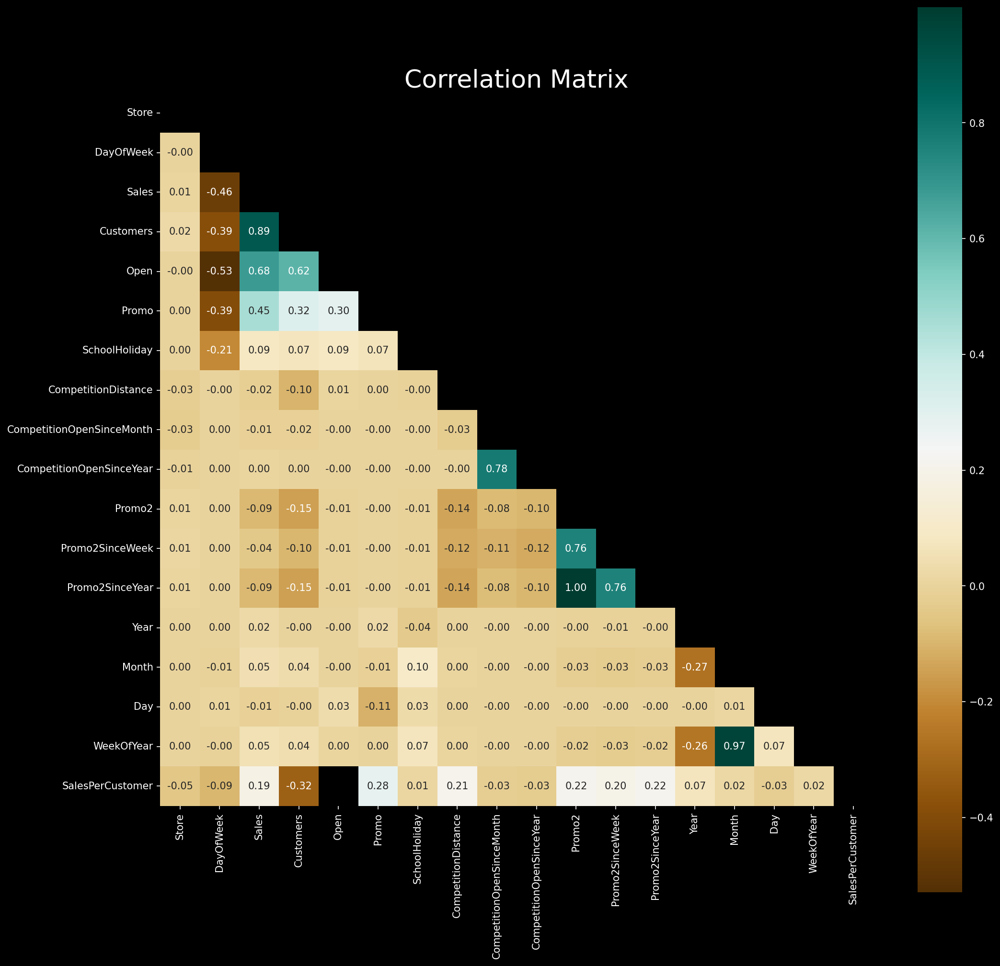

In [35]:
corr = df.corr(numeric_only=True)

# CREATING A MASK FOR UPPER TRIANLGULAR CORRELATION MATRIX
mask_ = np.zeros_like(corr,dtype=np.bool_)
mask_[np.triu_indices_from(mask_)] = True

plt.figure(figsize=(16,16),dpi=150)
sns.heatmap(corr,mask=mask_,annot=True,linewidths=0,
            square=True,cmap="BrBG",fmt='.2f') 
plt.title('Correlation Matrix',fontsize=25)
plt.show()

## ECDF: Empirical Cumulative Distribution Function
* Returns the Empirical CDF of an array as a step function.
* ECDF is a step function that provides the proportion or count of observations that are less than or equal to a particular value in the dataset.

In [37]:
ecdf_sales = ECDF(df['Sales'])
ecdf_customers = ECDF(df['Customers'])
ecdf_salespercust = ECDF(df['SalesPerCustomer'])
type(ecdf_sales)

statsmodels.distributions.empirical_distribution.ECDF

In [35]:
ecdf_sales.n , ecdf_sales.side , ecdf_sales.x, ecdf_sales.y

(1017210,
 'right',
 array([  -inf,     0.,     0., ..., 38484., 38722., 41551.]),
 array([0.00000000e+00, 9.83082139e-07, 1.96616428e-06, ...,
        9.99998034e-01, 9.99999017e-01, 1.00000000e+00]))

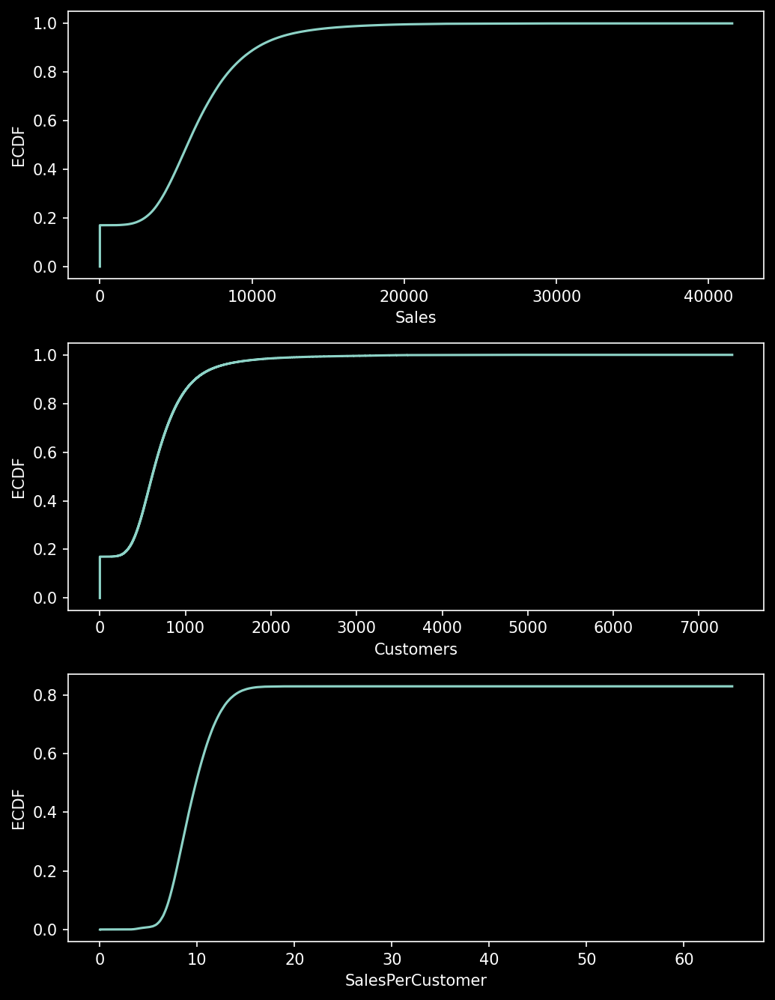

In [38]:
plt.figure(figsize=(7,9),dpi=150)

plt.subplot(311)
plt.plot(ecdf_sales.x,ecdf_sales.y,label='ECDF_Sales')
plt.xlabel('Sales')
plt.ylabel('ECDF')

plt.subplot(312)
plt.plot(ecdf_customers.x,ecdf_customers.y,label='ECDF_Customers')
plt.xlabel('Customers')
plt.ylabel('ECDF')

plt.subplot(313)
plt.plot(ecdf_salespercust.x,ecdf_salespercust.y,label='ECDF_SalesPerCustomer')
plt.xlabel('SalesPerCustomer')
plt.ylabel('ECDF')

plt.tight_layout()
plt.show()

**Inference:**
* About 80% of Sales values are less than 1000
* Also,, 0 Sales are due to Stores Closing

In [37]:
type(df['StateHoliday'][0])

str

In [38]:
# GETTING HOW MUCH PERCENT OF SALES ARE OF ZERO

len(df[df['Sales'] == 0]) * 100 / len(df) 

16.994639253093514

### Seaborn + Plolty Plots

In [39]:
df[['Store','StoreType']].drop_duplicates()

,Store,StoreType
0,1,c
1,2,a
2,3,a
3,4,c
4,5,a
...,...,...
1110,1111,a
1111,1112,c
1112,1113,a
1113,1114,a


#### **StoreType + Sales**

In [40]:
df['StoreType'].value_counts()

a    551627
d    312912
c    136840
b     15830
Name: StoreType, dtype: int64

In [41]:
df.StateHoliday.value_counts()

0    855087
0    131072
a     20260
b      6690
c      4100
Name: StateHoliday, dtype: int64

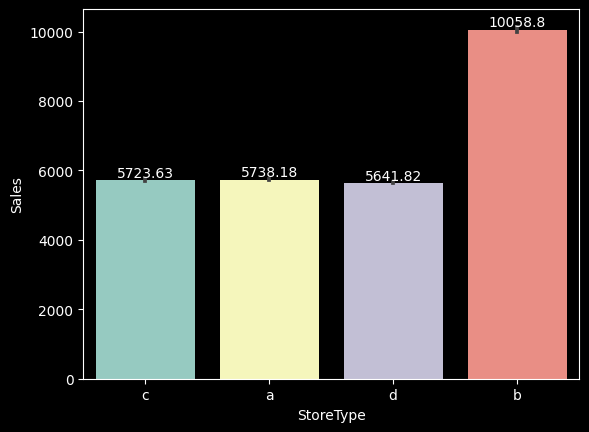

In [39]:
# plt.rcParams['figure.figsize'] = (3,2)

ax = sns.barplot(x='StoreType', y='Sales', data=df)
for container in ax.containers:
    ax.bar_label(container)

**Inference:**
* Value Counts for StoreType 'b' are less
* But Sales for that Type are high

<Axes: xlabel='StoreType', ylabel='Sales'>

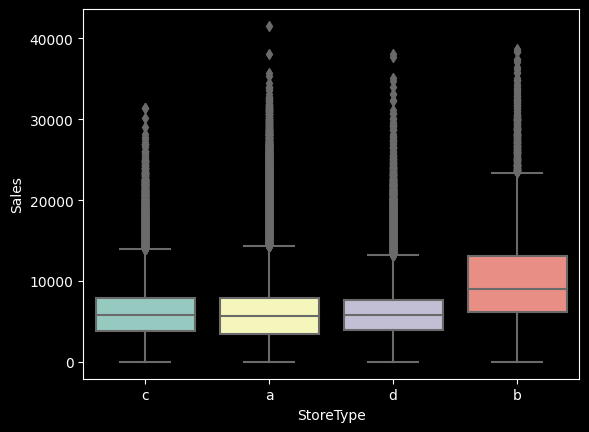

In [43]:
sns.boxplot(x='StoreType', y='Sales', data=df)

**Inference:**
* Range(Levels) of Sales obtained by Stores of Type a,c,d are similar.

#### **Assortment + Sales** 
Assortment ==> a = basic, b = extra, c = extended

<Axes: xlabel='Assortment', ylabel='Sales'>

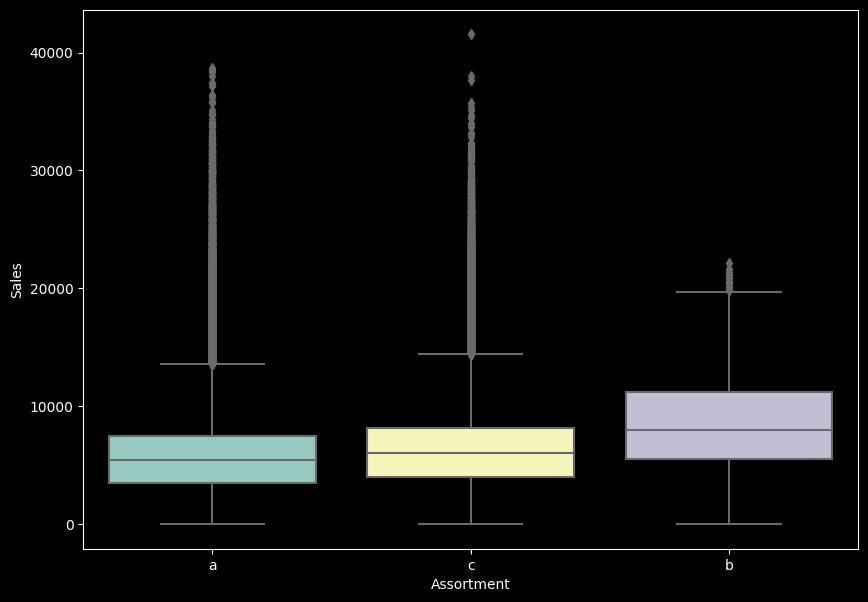

In [44]:
plt.figure(figsize=(10,7))
sns.boxplot(x='Assortment', y='Sales', data=df)

**Inference:**
* For Stores of Assortment level of Extra,,have somewhat more sales

#### **DayOfWeek + Open**

Text(0.5, 1.0, 'Number of Open & Close Stores in a WeekDay')

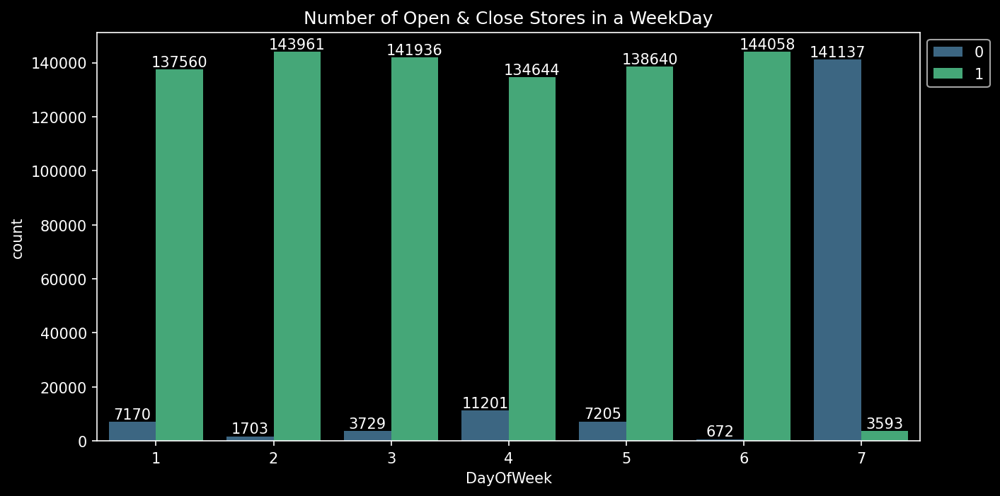

In [45]:
plt.figure(figsize=(10,5),dpi=150)
ax = sns.countplot(data=df,x='DayOfWeek',hue='Open',palette='viridis')

for container in ax.containers:
    ax.bar_label(container)
    
ax.legend(bbox_to_anchor=(1, 1))

plt.title('Number of Open & Close Stores in a WeekDay')

**Inference:**
* In WeekDays Closing of Stores are high in Thursday,,on comparing with other WeekDays
* On Sunday,,most of the Stores are Closed
* On Saturday,,most of the Stores are Opened,,and also very less number of Stores are Closed on comparing with that of other WeekDays 

#### **DayOfWeek + Promo**

Text(0.5, 1.0, 'Promo Count per WeekDay')

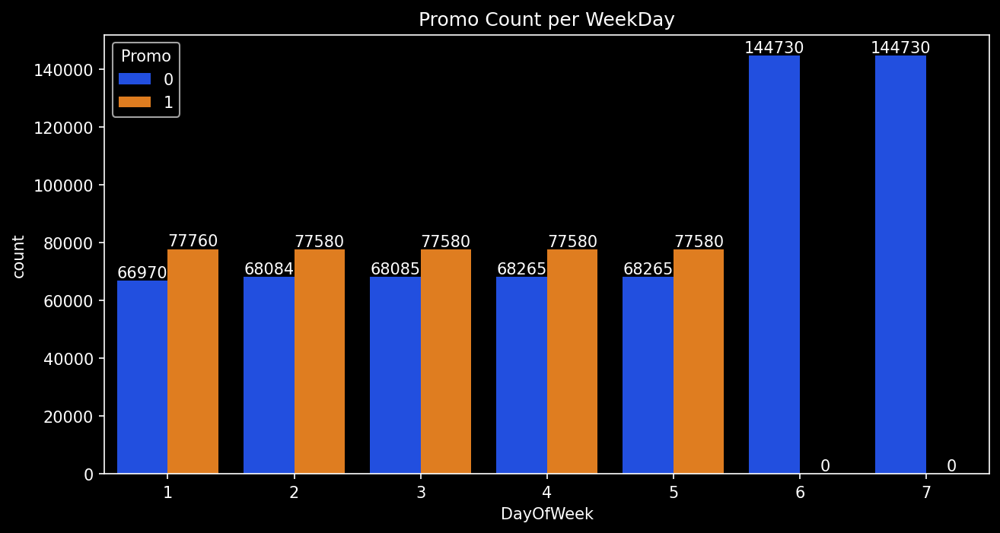

In [46]:
plt.figure(figsize=(10,5),dpi=150)

ax = sns.countplot(data=df,x='DayOfWeek',hue='Promo',palette='bright')
for container in ax.containers:
    ax.bar_label(container)

plt.title('Promo Count per WeekDay')

**Inference:**
* There are 0 promos done in WeekDays 6 & 7 (Saturday & Sunday)
* On other Days,,nearly Same amount of Promo's & Non-Promo's are being done

#### **DayOWeek + Promo + Sales** 
On a particular day,,we want to know that how the sales are being done if Propmo's are present and if Promo's are not Present

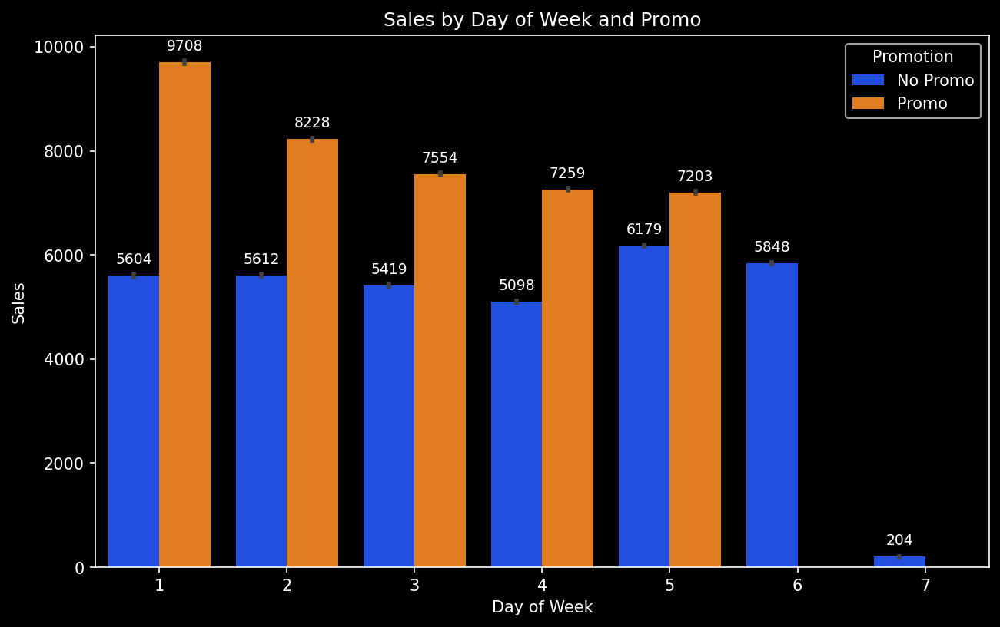

In [47]:
# sns.set(style="dark")
plt.figure(figsize=(10, 6),dpi=150)

ax = sns.barplot(x='DayOfWeek', y='Sales', hue='Promo', data=df, palette='bright')
ax.set_title('Sales by Day of Week and Promo')
ax.set_xlabel('Day of Week')
ax.set_ylabel('Sales')

# Adding data labels
for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points', fontsize=9)

# Improving legend
# Changing the legend labels
new_labels = {1: 'Promo', 0: 'No Promo'}
handles, _ = ax.get_legend_handles_labels()
ax.legend(handles, [new_labels[int(label.get_text())] for label in ax.get_legend().get_texts()], title='Promotion',loc='upper right')

plt.show()

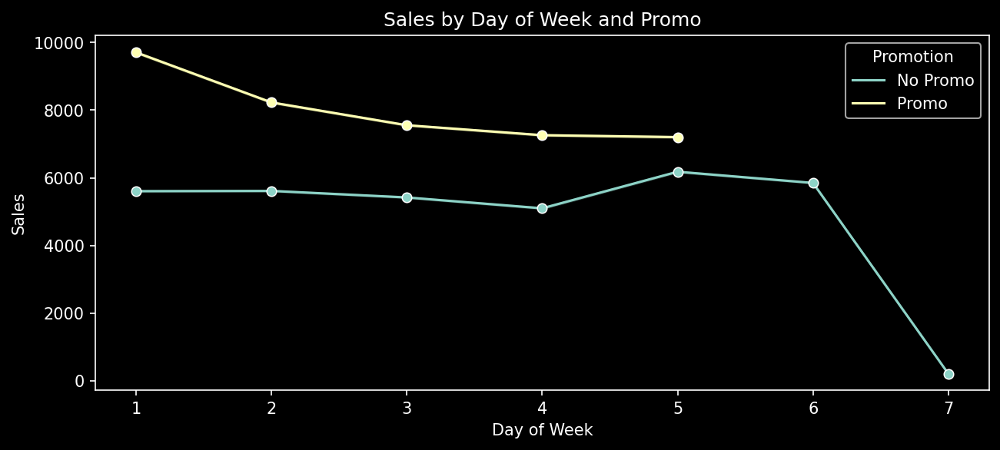

In [48]:
plt.figure(figsize=(10, 4),dpi=150)
ax = sns.lineplot(x='DayOfWeek', y='Sales', hue='Promo', marker='o', data=df)
ax.set_title('Sales by Day of Week and Promo')
ax.set_xlabel('Day of Week')
ax.set_ylabel('Sales')

# Changing the legend labels
new_labels = {1: 'Promo', 0: 'No Promo'}
handles, _ = ax.get_legend_handles_labels()
ax.legend(handles, [new_labels[int(label.get_text())] for label in ax.get_legend().get_texts()], title='Promotion')

plt.show()

**Inference:**
* From above plots,,we can say that,,Sales are more in those WeekDays where Promo's are Present.
* Also,in Saturday,Sunday,,there are no Promo's.
* With Promo's,
  * Sales are higher on Monday,also in decreasing manner from Monday to Friday
* With Out Promo's
  * Sales are somewhat same on Monday,Tuesday,wednesday,Thursday,,Slightly increased in Friday,then little bit decreased for Saturday,,Much decreased for Sunday.

#### **Promo + Sales && Promo + Customers**

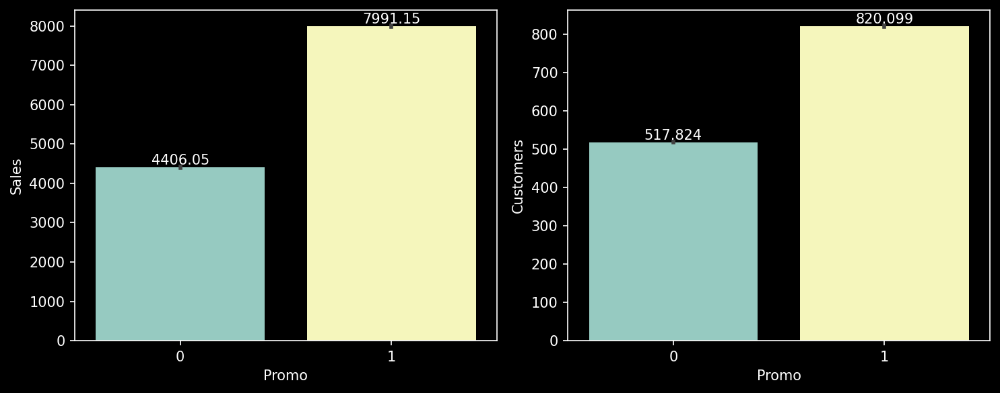

In [49]:
fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(10,4),dpi=150)

bar_plot1 = sns.barplot(data=df,x='Promo',y='Sales',ax = ax[0])
for container in bar_plot1.containers:
    bar_plot1.bar_label(container)

bar_plot2 = sns.barplot(data=df,x='Promo',y='Customers',ax = ax[1])
for container in bar_plot2.containers:
    bar_plot2.bar_label(container)

plt.tight_layout()

**Inference:**
* Whenever there are more Promo's more Sales are being done.

#### **Date + Sales**

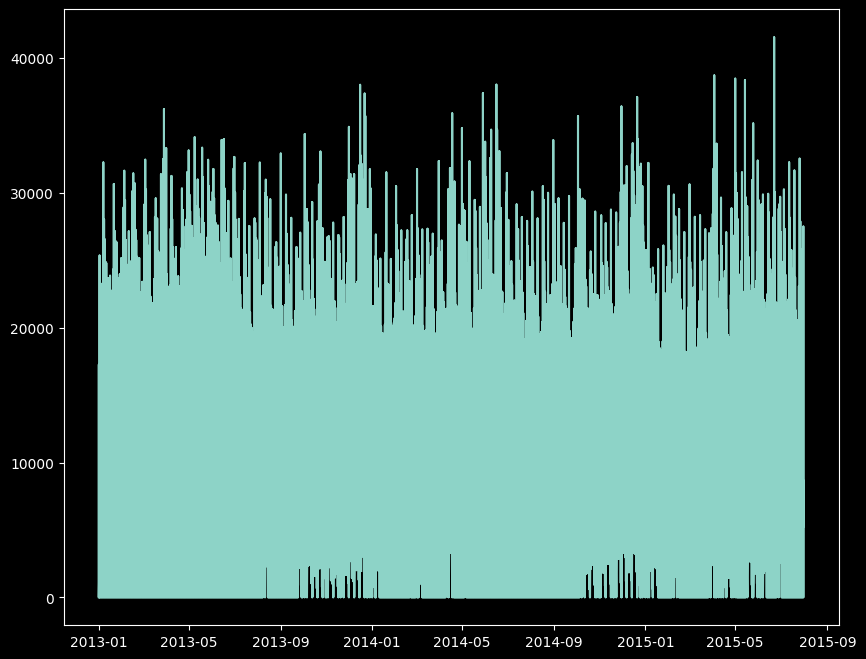

In [50]:
plt.figure(figsize=(10,8))
plt.plot(df['Date'],df['Sales'])

#### **DayOfWeek + Sales**

<Axes: xlabel='DayOfWeek', ylabel='Sales'>

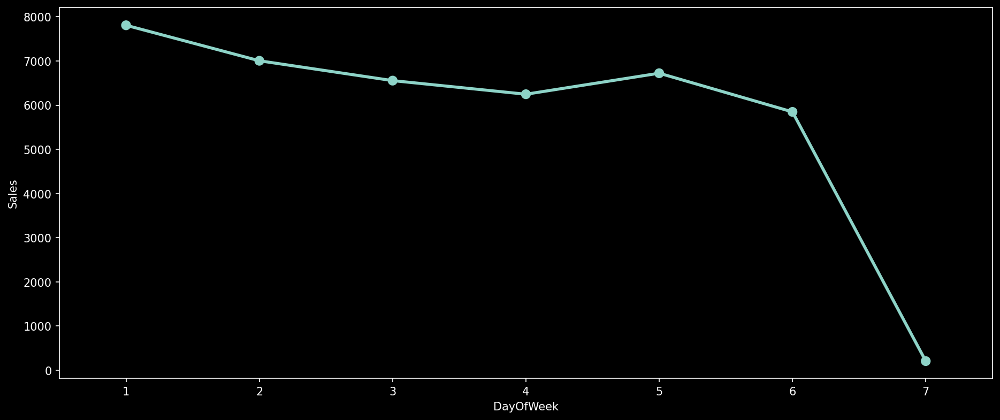

In [51]:
plt.figure(figsize=(15,6),dpi=150)
sns.pointplot(x='DayOfWeek', y='Sales', data=df)

**Inference:**
* On Monday,there are high Sales
* As Stores are Colsed on Sundays,,there are less Sales in that day

#### **WeekOfYear + Sales**
**Grouping by WeekOfYear**

In [52]:
avg_sales_by_week = df.groupby(by='WeekOfYear')['Sales'].mean()
pct_change_sales_by_week = df.groupby(by='WeekOfYear')['Sales'].sum().pct_change()

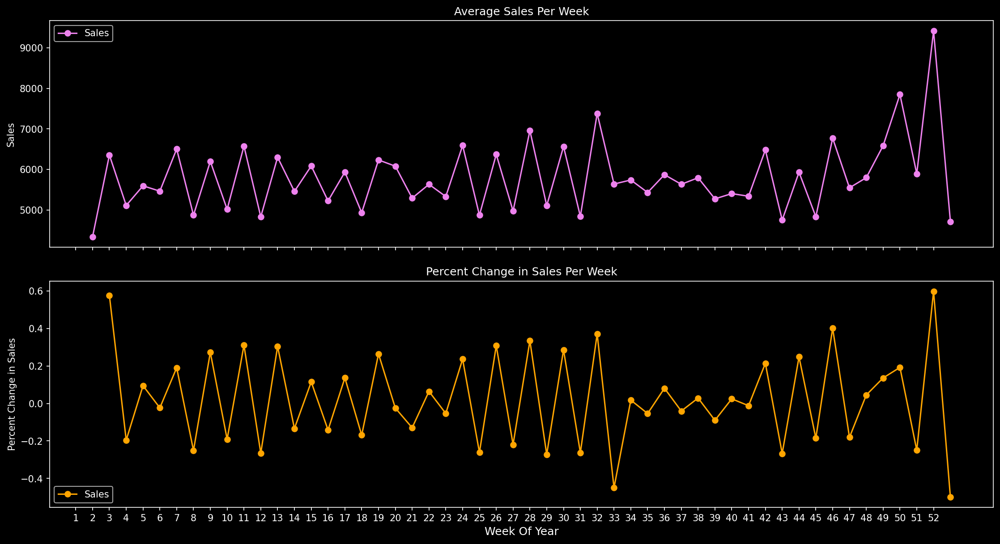

In [53]:
fig, ax = plt.subplots(2,1,sharex=True,figsize=(15,8),dpi=150)

ax1 = avg_sales_by_week.plot(legend=True,title='Average Sales Per Week',
                              marker='o',ax=ax[0],color='violet')
ax1.set_xticks(range(len(avg_sales_by_week)))
ax1.set_xticklabels(avg_sales_by_week.index.tolist(),rotation=45, ha="right")
ax1.set_ylabel('Sales')
plt.tight_layout()

ax2 = pct_change_sales_by_week.plot(legend=True,title='Percent Change in Sales Per Week',
                               marker='o',ax=ax[1],color='orange')
ax2.set_ylabel('Percent Change in Sales')
plt.xlabel('Week Of Year',size=12)
plt.subplots_adjust(hspace=0.15)

#### **CompetitionOpenSinceYear + Sales**

<Axes: xlabel='CompetitionOpenSinceYear', ylabel='Sales'>

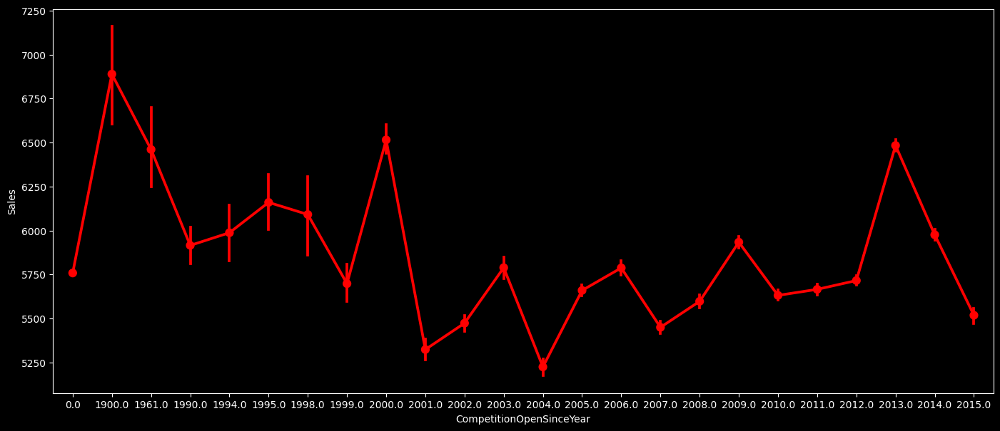

In [54]:
plt.figure(figsize=(17,7))
sns.pointplot(data=df,x='CompetitionOpenSinceYear',y='Sales',color='red')

**Inference:**
* At 1900's,,Sales are high,,because at that time there will be Less Competition
* But as time goes on,,more Stores are opened,,leading to less number of Sales

#### **Promo2SinceYear + Sales** 

<Axes: xlabel='Promo2SinceYear', ylabel='Sales'>

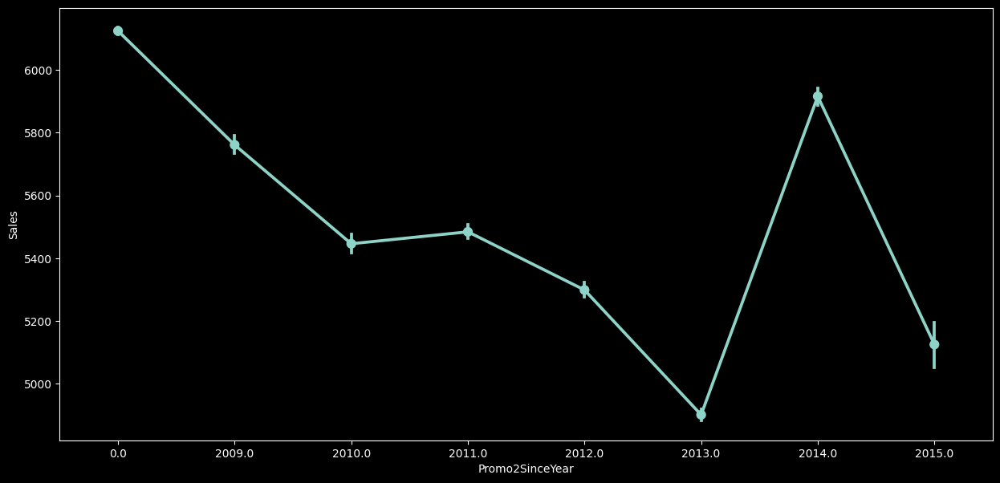

In [55]:
plt.figure(figsize=(15,7))
sns.pointplot(data=df,x='Promo2SinceYear',y='Sales')

#### **CompetitionOpenSinceMonth + Sales**

<Axes: xlabel='CompetitionOpenSinceMonth', ylabel='Sales'>

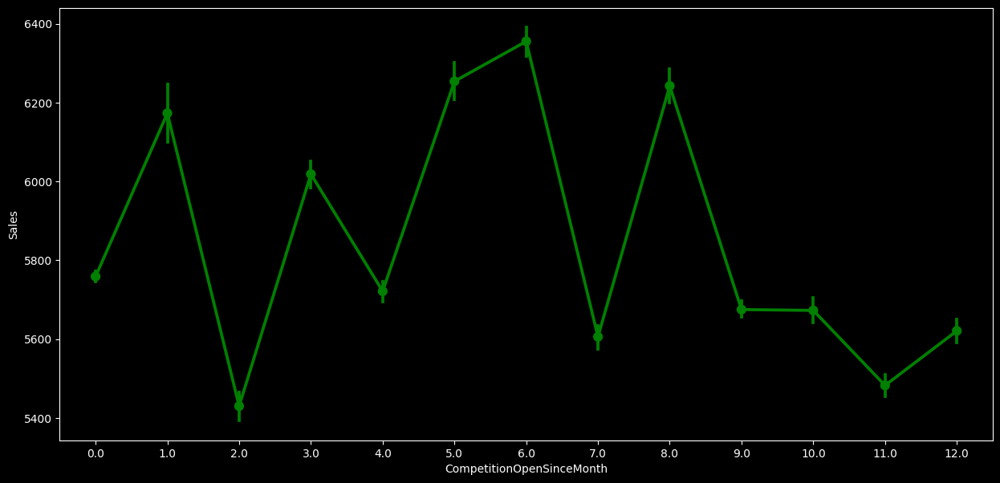

In [56]:
plt.figure(figsize=(15,7))
sns.pointplot(data=df,x='CompetitionOpenSinceMonth',y='Sales',color='green')

### State Holiday

In [57]:
crosstab_result = pd.crosstab(df['Open'], df['StateHoliday'],margins=True)
crosstab_result

StateHoliday,0,0,a,b,c,All
Open,,,,,,
0,18932,123745,19566,6545,4029,172817
1,112140,731342,694,145,71,844392
All,131072,855087,20260,6690,4100,1017209


**Inference:**
* From above CrossTab Result,we can say that,,mostly,on State Holidays,,,stores are Closed

#### **StateHoliday + Sales**

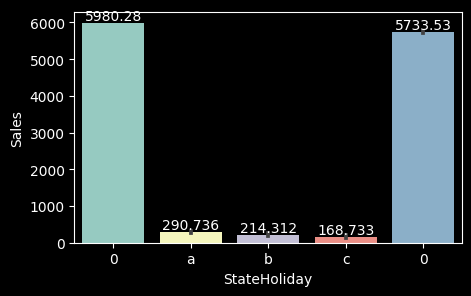

In [58]:
plt.figure(figsize=(5,3))
ax = sns.barplot(data=df,x='StateHoliday',y='Sales')

# Add labels to the bars
for container in ax.containers:
    ax.bar_label(container)

**Inference:**
* **On comparing on those holidays,,on Public Holiday there are more Sales,,after that Easter Holiday,,Christmas**

### School Holiday

<Axes: xlabel='SchoolHoliday', ylabel='Sales'>

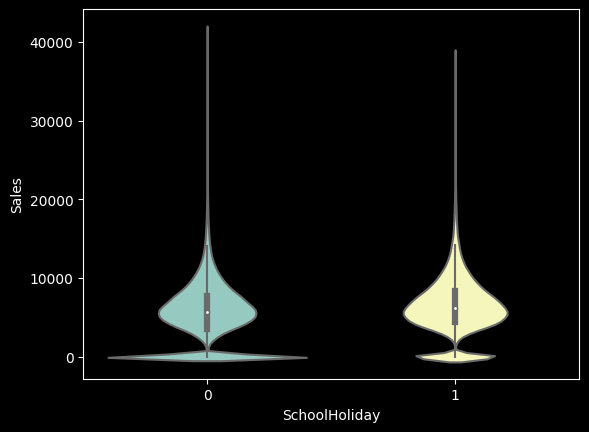

In [59]:
sns.violinplot(data=df,x='SchoolHoliday',y='Sales')

In [60]:
# df.query('SchoolHoliday == 0 and Sales ==0')['DayOfWeek'].value_counts()

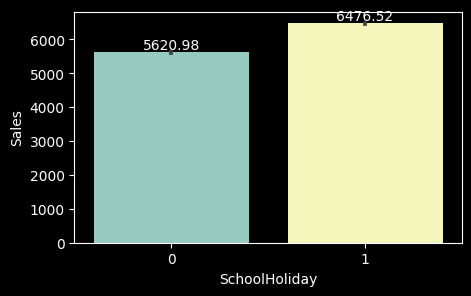

In [61]:
plt.figure(figsize=(5,3))
ax = sns.barplot(data=df,x='SchoolHoliday',y='Sales',)

# Add labels to the bars
for container in ax.containers:
    ax.bar_label(container)

**Inference:**
* If there are School Holidays,,some what there are more Sales on comparing with not having School Holidays

#### **CrossTab for Open + SchoolHoliday**

In [62]:
crosstab_result = pd.crosstab(df['Open'], df['SchoolHoliday'],margins=True)
crosstab_result

SchoolHoliday,0,1,All
Open,,,
0,154553,18264,172817
1,680935,163457,844392
All,835488,181721,1017209


**Inference:**
* On comparing Crosstab results of State Holidays and School Hoildays,,
  * If there is holidays,,means StateHoliday == [a,b,c],,SchoolHoliday == 1,, \
    Number of Stores opened in those StateHolidays < Number of Stores opened in SchoolHolidays
* It may also means that,,Stores are not much caring about School Holidays,,menas there is no such things like strikes on those SchoolHolidays    

#### **Creating a Fucntion,which takes any 2 Store ID's and Date Range as input**
* Plots Sales for both 

In [63]:
def get_info_about_two_stores(store_id1,store_id2,start_date,end_date):
    
    store1_data = df.query(
    f'Store == {store_id1} and Sales != 0 and Date >= @start_date and Date <= @end_date'
    )
    num = 882
    store2_data = df.query(
    f'Store == {store_id2} and Sales != 0 and Date >= @start_date and Date <= @end_date'
    )
    
    # Create a line plot using Plotly
    fig = go.Figure()

    # Add traces for each line
    fig.add_trace(go.Scatter(x=store1_data['Date'], y=store1_data['Sales'], 
                             mode='lines', name='Sales A', line=dict(color='green')))
    fig.add_trace(go.Scatter(x=store2_data['Date'], y=store2_data['Sales'], 
                             mode='lines', name='Sales B',line=dict(color='orange')))

    # Update layout and axis titles
    fig.update_layout(title='Sales Comparison')
    fig.update_xaxes(title='Date')
    fig.update_yaxes(title='Sales')

    # Show the figure
    fig.show()

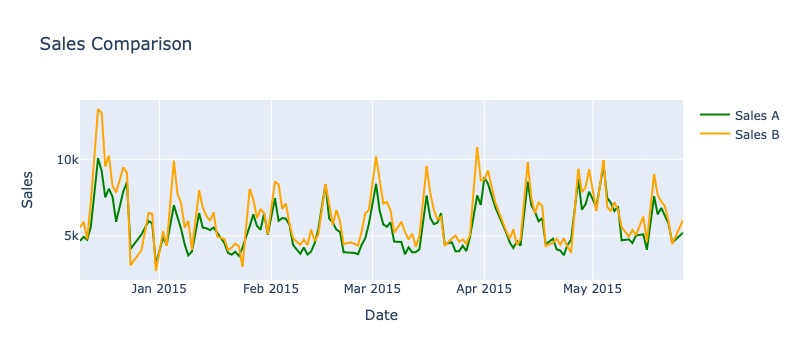

In [64]:
import plotly.graph_objects as go
get_info_about_two_stores(1008,516,'2014-12-10','2015-05-26')

#### **Creating a function which takes a Stores ID & Date_Range,,and makes some plots for that Store**

For a Store,,info we can present is
* Daily Sales(Date + Sales)
* Daily Customers(Date + Customers)
* In a given Date_Range,,how may days,,,is that Store is Opened/Closed
* For a Date_Range,,,How many Promo's are done for that Store
* Sales trend in State Holidays and SchoolHolidays for that Store,,in a given date_range
* Sales per Year,Week,Day,Week of year
* Number of days where Store got zero sales,,even store is opened,,,sales may be zero due to some extra factors

In [65]:
# LET'S FOR TESTING,,,SELECT A DATE RANGE AND A RANDOM STORE NUMBER
store_id = 803
start_date = '2011-12-10'
end_date = '2017-05-26'
test_df = df.query(f'Store == {store_id} and Sales != 0 and Date >= @start_date and Date <= @end_date')

In [66]:
print('\033[1m'+f'Total Number of Records,,in our dataset for {store_id} Store from {start_date} to {end_date} : '+'\033[0m',
      len(test_df))
print('\033[1m'+f'Total Number of Records where Store is opened are : '+'\033[0m',
      len(test_df.query('Open == 1')))
print('\033[1m'+f'Total Number of Records where Promotions happened are : '+'\033[0m',
      len(test_df.query('Promo == 1')))
print('\033[1m'+f'Total Number of Records of State Holidays are : '+'\033[0m',
      len(test_df.query('StateHoliday == 1')))
print('\033[1m'+f'Total Number of Records of School Holidays are : '+'\033[0m',
      len(test_df.query('SchoolHoliday == 1')))

Total Number of Records,,in our dataset for 803 Store from 2011-12-10 to 2017-05-26 :  769
Total Number of Records where Store is opened are :  769
Total Number of Records where Promotions happened are :  345
Total Number of Records of State Holidays are :  0
Total Number of Records of School Holidays are :  148


In [67]:
# TOTAL SALES PER YEAR FOR THAT STORE
# test_df.groupby('Year')['Sales'].sum().plot(kind='bar')

In [68]:
# GETTING SALES AS PER DATE
# px.line(data_frame=test_df,x='Date',y='Sales')

In [69]:
grouped_df = test_df.groupby(['Year','Month','WeekOfYear','Day'])['Sales'].sum().reset_index()
# grouped_df

In [70]:
# CONVERTING MONTH NUMBER TO MONTH NAME
grouped_df['Month_name'] = grouped_df['Month'].apply(lambda x: pd.to_datetime(str(x),format='%m').strftime('%B'))

In [71]:
# grouped_df

**Plotting Monthly Sales for Store Year wise**

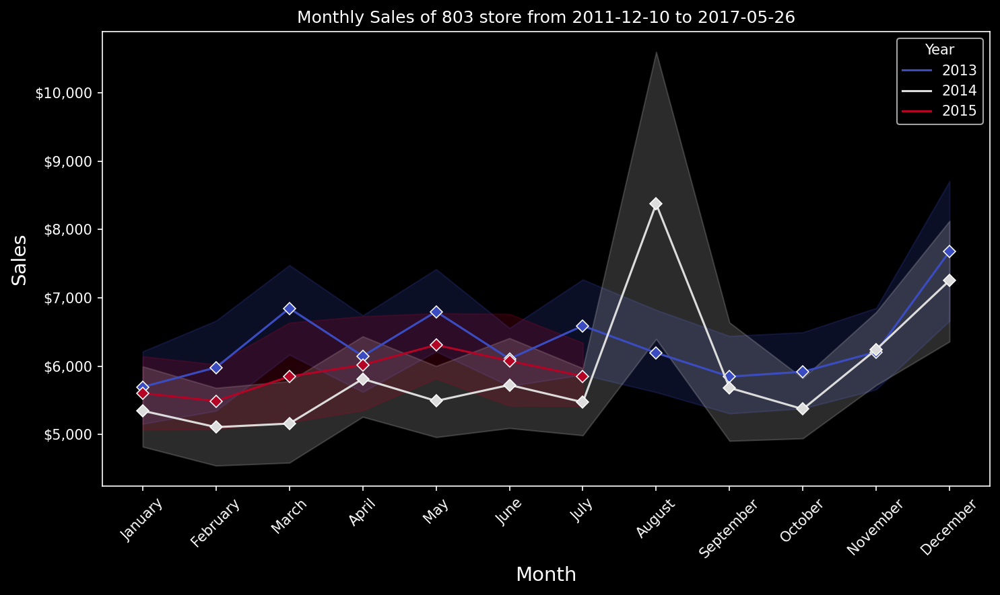

In [72]:
plt.figure(figsize=(10, 6),dpi=150)
sns.lineplot(data=grouped_df, x='Month_name', y='Sales', hue='Year',
             palette='coolwarm', marker='D')
# Customize the plot
plt.title(f'Monthly Sales of {store_id} store from {start_date} to {end_date}')
plt.xlabel('Month',fontsize=14)
plt.ylabel('Sales',fontsize=14)
plt.xticks(rotation=45)
# plt.grid(True)
plt.legend(title='Year')
plt.style.use('dark_background')
plt.gca().get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "${:,}".format(int(x))))

# Show the plot
plt.tight_layout()
plt.show()

**Monthly Sales Analysis**

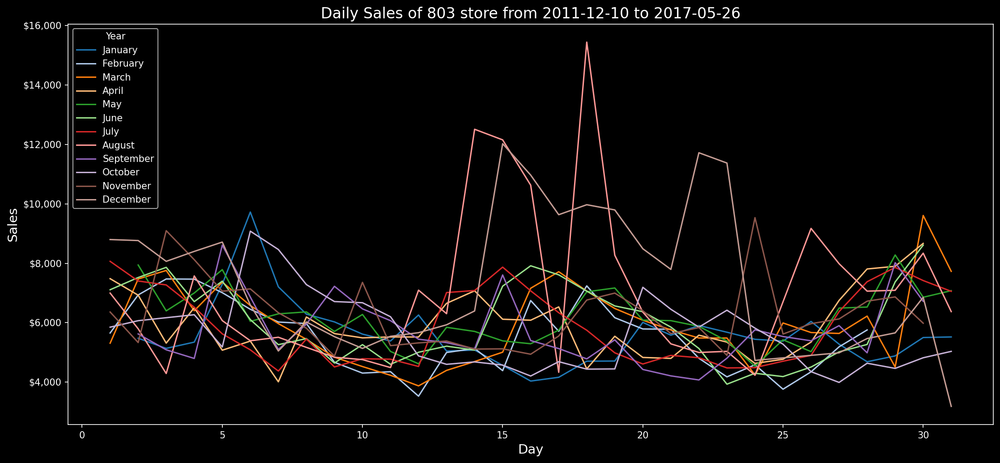

In [73]:
plt.figure(figsize=(15, 7),dpi=150)
sns.lineplot(data=grouped_df, x='Day', y='Sales', hue='Month_name', 
             palette='tab20',errorbar=None)
plt.title(f'Daily Sales of {store_id} store from {start_date} to {end_date}', fontsize=16)
plt.xlabel('Day', fontsize=14)
plt.ylabel('Sales', fontsize=14)
# plt.grid(True)
plt.legend(title='Year', loc='upper left')

# Format y-axis labels with Dollars
plt.gca().get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "${:,}".format(int(x))))

# Show the plot
plt.tight_layout()
plt.show()

In [74]:
quarter_bins = [0, 3, 6, 9, 12]   # Months 1-3, 4-6, 7-9, 10-12

grouped_df['Quarter'] = pd.cut(grouped_df['Month'], bins=quarter_bins,
                               labels=['Q1', 'Q2', 'Q3', 'Q4'])

**Quarterly Sales Analysis Year-wise**

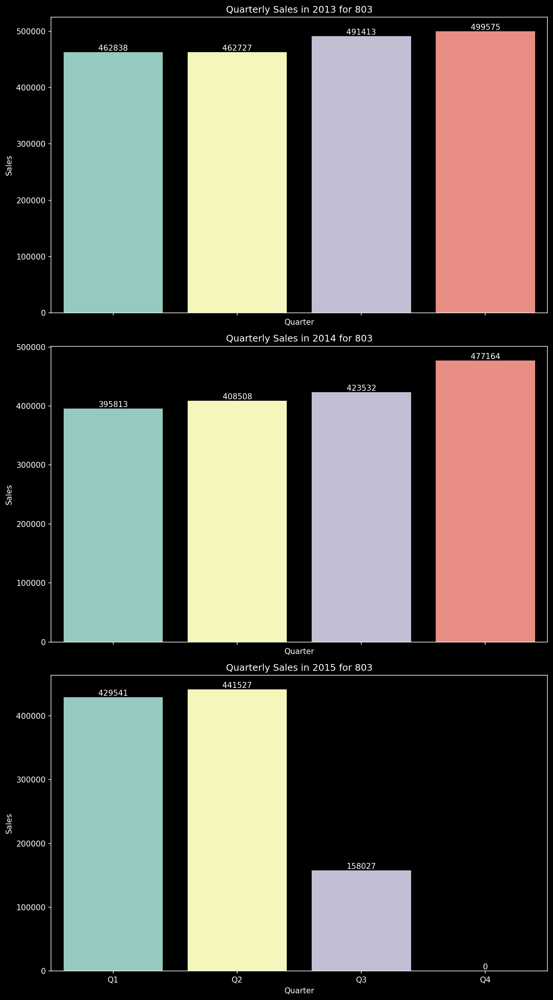

In [75]:
# Create subplots for each year
fig, axes = plt.subplots(nrows=len(grouped_df['Year'].unique()), 
                         figsize=(10, 18), sharex=True,dpi=150)

# Iterate over unique years and create subplots
for i, year in enumerate(grouped_df['Year'].unique()):
    ax = axes[i]
    year_data = grouped_df[grouped_df['Year'] == year]
    
    # Group by Quarter and sum the Sales
    quarterly_sales = year_data.groupby('Quarter')['Sales'].sum().reset_index()
    
    # Plotting using seaborn
    bar_plot = sns.barplot(data=quarterly_sales, x='Quarter', y='Sales', ax=ax)
    #sns.lineplot(data=quarterly_sales, x='Quarter', y='Sales', marker='o', ax=ax)
    for container in bar_plot.containers:
        bar_plot.bar_label(container)

    
    ax.set_title(f'Quarterly Sales in {year} for {store_id}')
    ax.set_xlabel('Quarter')
    ax.set_ylabel('Sales')
    ax.set_xticklabels(quarterly_sales['Quarter'])
    
plt.tight_layout()
plt.show()


In [76]:
grouped_df = test_df.groupby(['Year','Month','WeekOfYear','Day'])['Customers'].mean().reset_index()
# grouped_df

# CONVERTING MONTH NUMBER TO MONTH NAME
grouped_df['Month_name'] = grouped_df['Month'].apply(lambda x: pd.to_datetime(str(x),format='%m').strftime('%B'))

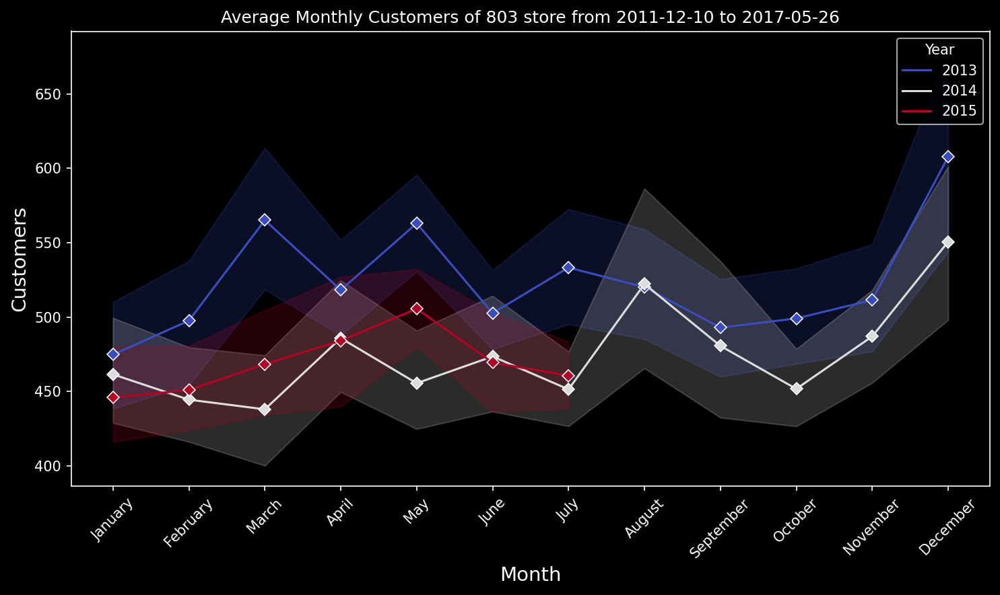

In [77]:
plt.figure(figsize=(10, 6),dpi=150)
sns.lineplot(data=grouped_df, x='Month_name', y='Customers', hue='Year',
             palette='coolwarm', marker='D')
# Customize the plot
plt.title(f'Average Monthly Customers of {store_id} store from {start_date} to {end_date}')
plt.xlabel('Month',fontsize=14)
plt.ylabel('Customers',fontsize=14)
plt.xticks(rotation=45)
# plt.grid(True)
plt.legend(title='Year')
plt.style.use('dark_background')

# Show the plot
plt.tight_layout()
plt.show()

#### **Trends based on Promo + Sales**

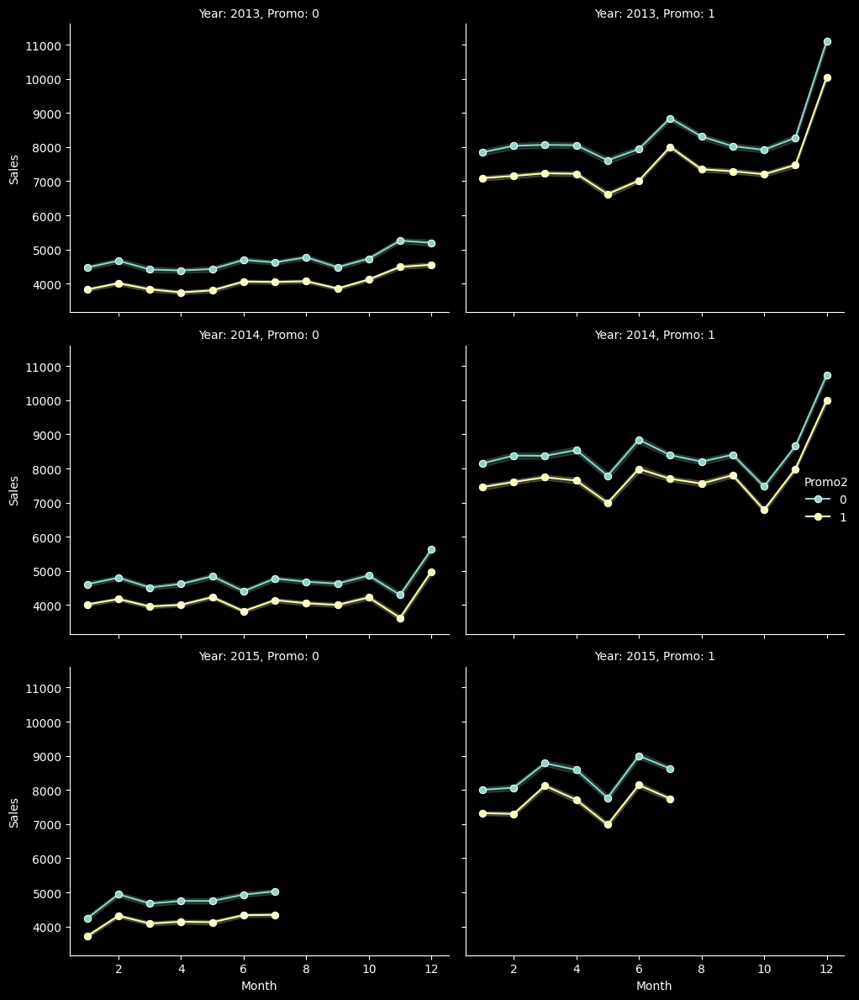

In [78]:
g = sns.FacetGrid(df, col='Promo', row='Year', hue='Promo2', height=4, aspect=1.2)
g.map(sns.lineplot, 'Month', 'Sales', marker='o')

g.add_legend()
g.set_titles('Year: {row_name}, Promo: {col_name}')
g.set_axis_labels('Month', 'Sales')

# Show the plot
plt.tight_layout()
plt.show()

#### **Average Sales(Year wise) based on StoreType**

In [79]:
storetype_grouped_df = df.groupby(['StoreType','Year','Month'])['Sales'].mean().reset_index()

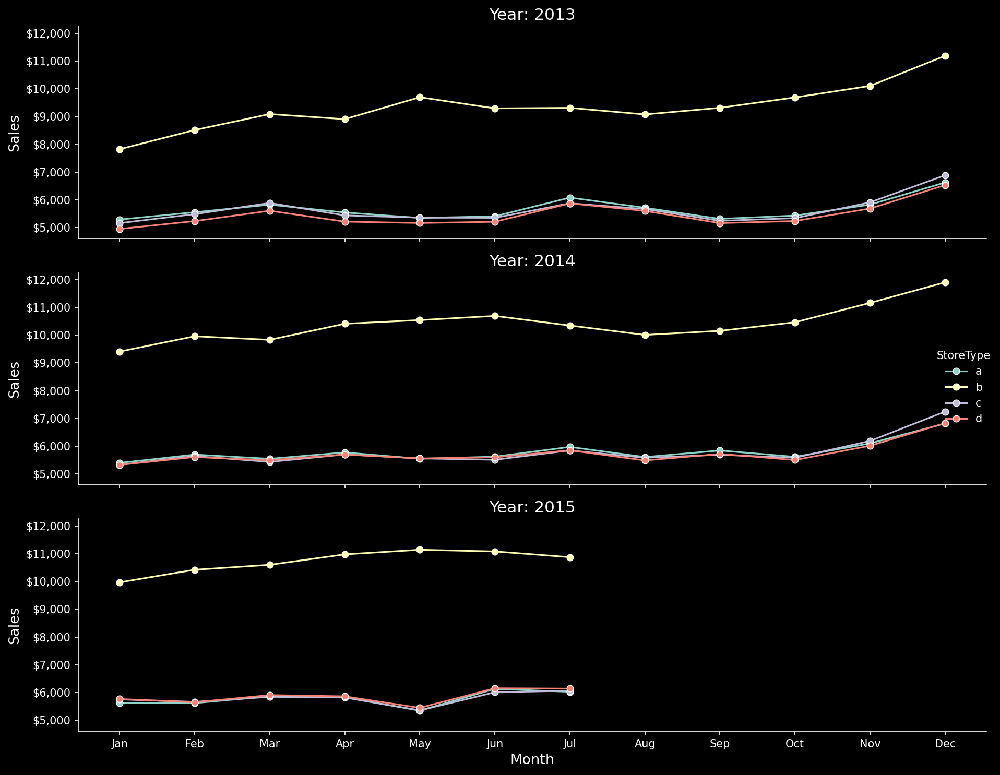

In [80]:
# MONTH NAMES TO SET AS X-TICK LABELS
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 
               'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

# FACETGRID
g = sns.FacetGrid(storetype_grouped_df,row='Year', hue='StoreType', height=4, aspect=1.2)
g.map(sns.lineplot, 'Month', 'Sales', marker='o') # MAPPING OUR FACET GRID WITH LINEPLOT

g.fig.set_size_inches(12, 10) # SETTING FIGSIZE OF FACETGRID
g.fig.set_dpi(150) # SETTING DPI

g.add_legend() # ADDING LEGEND
g.set_titles('Year: {row_name}', size=15)  # ADDING TITLES FOR EACH PLOT OF GRID
g.set_axis_labels('Month', 'Sales',size=13) # ADDING LABELS FOR X & Y AXES FOR EACH PLOT OF GRID

# SETTING XTICKS & LABELS
for ax in g.axes.flat:
    ax.set_xticks(range(1, 13))  # Set xticks for each month
    ax.set_xticklabels(month_names)  # Set xticklabels as month numbers

# FORMATTING Y-LABLES WITH DOLLAR SYMBOL
plt.gca().get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "${:,}".format(int(x))))

# Show the plot
plt.tight_layout()
plt.show()

# Time Series Analysis

## Stationarity
https://github.com/bisman16/Kaggle_Rossmann_Store_Sales_Forecasting/blob/master/Rossmann_Store_Analysis.ipynb
https://medium.com/analytics-vidhya/predicting-sales-time-series-analysis-forecasting-with-python-b81d3e8ff03f

In [82]:
pd.plotting.register_matplotlib_converters()

#### **Resample Function**
* Resample function in pandas is a powerful tool for time series analysis that allows you to change the frequency of your time series data. It is particularly useful when you have data sampled at a higher frequency and you want to **aggregate or downsample it to a lower frequency** (e.g., from daily to monthly).
* Resample function can be combined with various aggregation functions, allowing you to calculate **various statistics at different frequencies**.

In [83]:
# TAKING ONE STORE FROM EACH TYPE
sales_a = df[df['Store'] == 2].set_index('Date')['Sales']
sales_b = df[df['Store'] == 335].set_index('Date')['Sales']
sales_c = df[df['Store'] == 897].set_index('Date')['Sales']
sales_d = df[df['Store'] == 477].set_index('Date')['Sales']

sales_a_resampled = sales_a.resample(rule='W').sum()
sales_b_resampled = sales_b.resample(rule='W').sum()
sales_c_resampled = sales_c.resample(rule='W').sum()
sales_d_resampled = sales_d.resample(rule='W').sum()

**Plotting Resampled data**

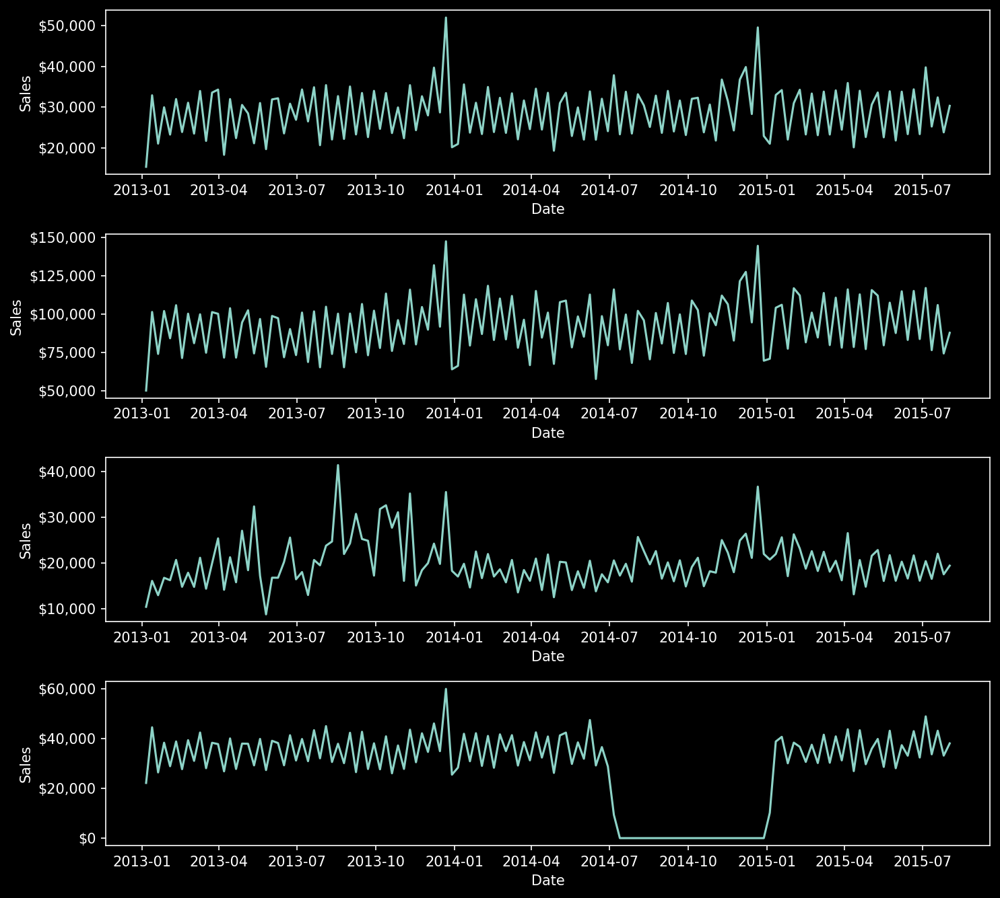

In [84]:
fig,ax = plt.subplots(nrows=4,ncols=1,figsize=(10,9),dpi=150)

ax[0].plot(sales_a_resampled)
ax[0].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, loc: "${:,}".format(int(x))))
ax[0].set_ylabel('Sales')
ax[0].set_xlabel('Date')

ax[1].plot(sales_b_resampled)
ax[1].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, loc: "${:,}".format(int(x))))
ax[1].set_ylabel('Sales')
ax[1].set_xlabel('Date')

ax[2].plot(sales_c_resampled)
ax[2].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, loc: "${:,}".format(int(x))))
ax[2].set_ylabel('Sales')
ax[2].set_xlabel('Date')

ax[3].plot(sales_d_resampled)
ax[3].yaxis.set_major_formatter(plt.FuncFormatter(lambda x, loc: "${:,}".format(int(x))))
ax[3].set_ylabel('Sales')
ax[3].set_xlabel('Date')

plt.tight_layout()

## **Augmented Dicky Fuller Test**

In [85]:
# FUNCTION TO CHECK STATIONARITY OF THE TIME SERIES DATA
# TIME_SERIES DATA HAS ONE DATE COLUMN AND OTHER SALES COLUMN
def test_stationarity(time_series):

  rolling_mean = pd.Series(time_series).rolling(window=7).mean()
  rolling_std = pd.Series(time_series).rolling(window=7).std()

  plt.figure(figsize=(10,5),dpi=150)
  # PLOTTING ROLLING STATS
  original = plt.plot(time_series.resample('W').mean(),
                      color='green',label='Original')
  mean = plt.plot(rolling_mean.resample('W').mean(),
                  color='red',label='Rolling Mean')
  std = plt.plot(rolling_std.resample('W').mean(),
                 color='orange',label='Rolling Std')
  plt.legend(loc='best')
  plt.title('Rolling Mean and Standard Deviation')
  plt.show(block=False)

  # PERFORM DICKEY FULLER TEST
  print('Results of Dickey Fuller Test')
  df_test = adfuller(time_series,autolag='AIC')
  df_output = pd.Series(df_test[0:4],
                        index=['Test Statistic','P-Value','#Lags used','#Observations used'])
  print('df_test is ',df_test)
  for key,value in df_test[4].items():
    df_output['Critical Value (%s)'%key] = value
  print(df_output)

In [86]:
ts_a = df[df['StoreType'] == 'a'].set_index('Date')['Sales']
# THIS ts_a HAS DATE,SALES COLUMNS,,,BUT DATE COLUMN HAS MORE REPEATING VALUES,,THAT MIGHT NOT BE  GOOD

In [87]:
# rolling_std = pd.Series(ts_a).resample('W').std()
# plt.plot(rolling_std,color='orange',label='Rolling Std')

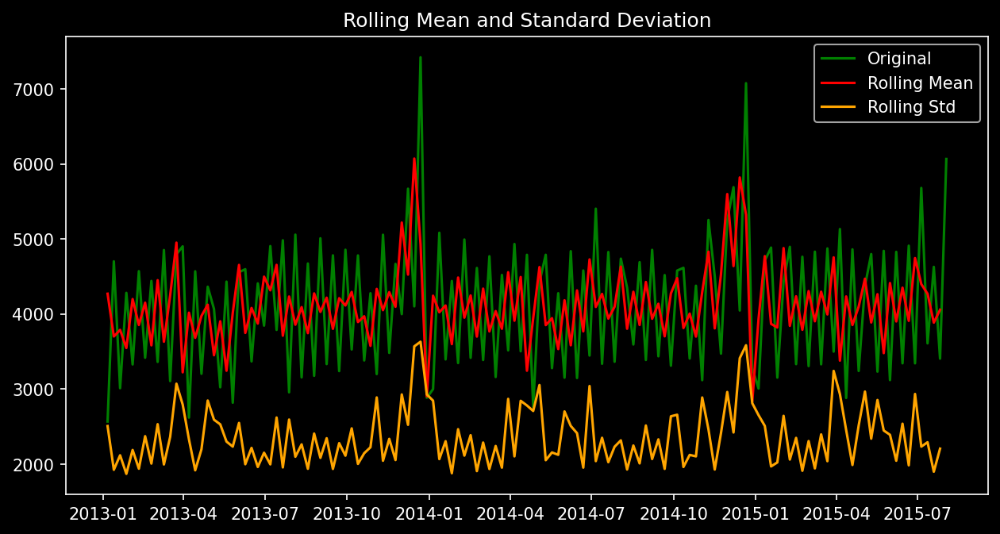

Results of Dickey Fuller Test
df_test is  (-6.21823699415033, 5.3008625708458395e-08, 21, 920, {'1%': -3.4374778690219956, '5%': -2.864686684217556, '10%': -2.5684454926748583}, 15906.295608911096)
Test Statistic         -6.218237e+00
P-Value                 5.300863e-08
#Lags used              2.100000e+01
#Observations used      9.200000e+02
Critical Value (1%)    -3.437478e+00
Critical Value (5%)    -2.864687e+00
Critical Value (10%)   -2.568445e+00
dtype: float64


In [88]:
test_stationarity(sales_a)

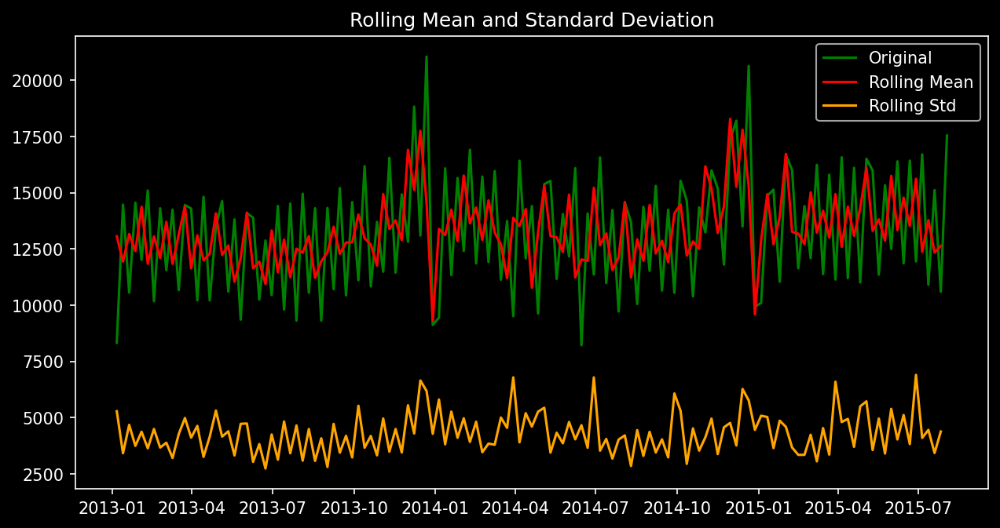

Results of Dickey Fuller Test
df_test is  (-5.755293210025321, 5.838851781734309e-07, 21, 920, {'1%': -3.4374778690219956, '5%': -2.864686684217556, '10%': -2.5684454926748583}, 17200.75995385193)
Test Statistic         -5.755293e+00
P-Value                 5.838852e-07
#Lags used              2.100000e+01
#Observations used      9.200000e+02
Critical Value (1%)    -3.437478e+00
Critical Value (5%)    -2.864687e+00
Critical Value (10%)   -2.568445e+00
dtype: float64


In [89]:
test_stationarity(sales_b)

In [91]:
sales_c

Date
2015-07-31    4691
2015-07-30    3833
2015-07-29    3498
2015-07-28    3450
2015-07-27    3953
              ... 
2013-01-05    2872
2013-01-04    2348
2013-01-03    2611
2013-01-02    2581
2013-01-01       0
Name: Sales, Length: 942, dtype: int32

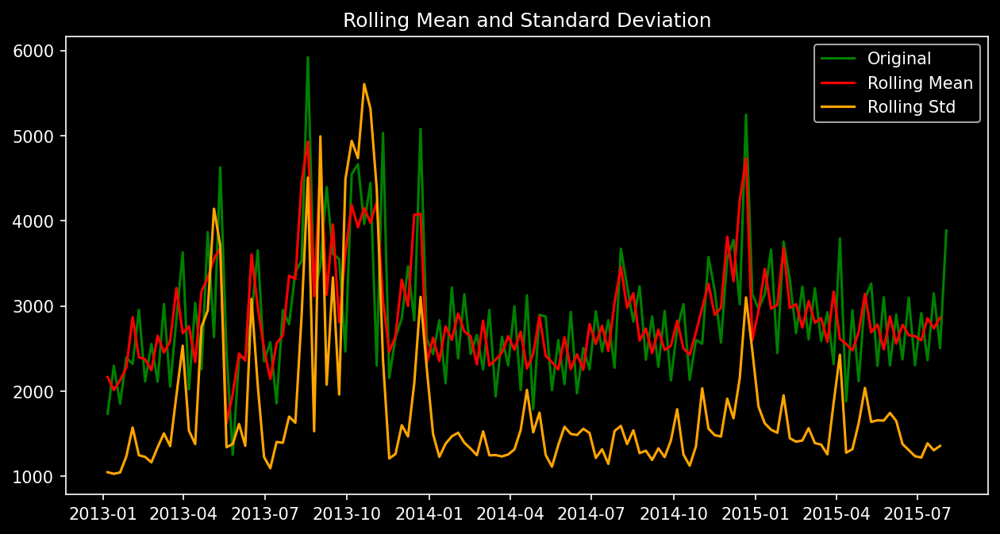

Results of Dickey Fuller Test
df_test is  (-4.2051963365920075, 0.0006456813634065225, 21, 920, {'1%': -3.4374778690219956, '5%': -2.864686684217556, '10%': -2.5684454926748583}, 16425.19337358734)
Test Statistic           -4.205196
P-Value                   0.000646
#Lags used               21.000000
#Observations used      920.000000
Critical Value (1%)      -3.437478
Critical Value (5%)      -2.864687
Critical Value (10%)     -2.568445
dtype: float64


In [92]:
test_stationarity(sales_c)

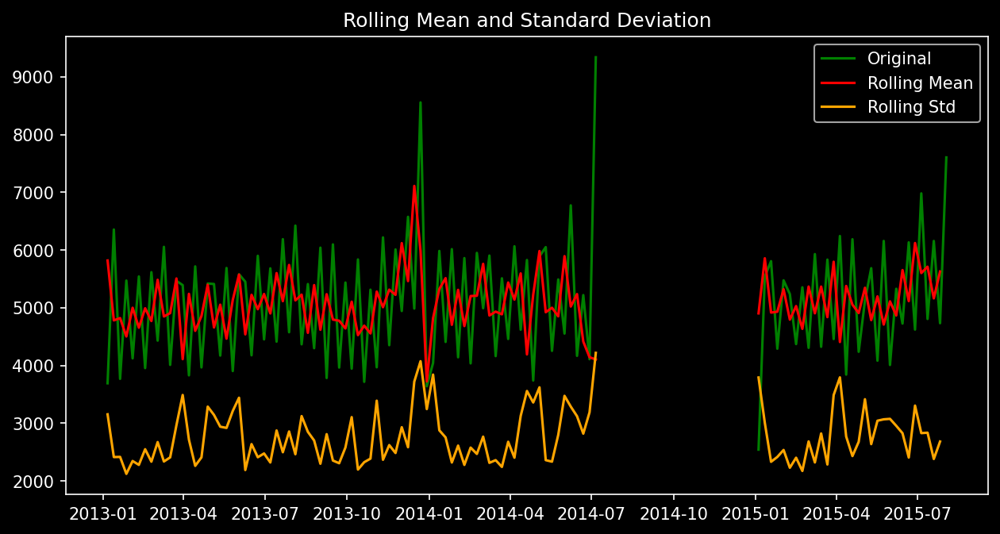

Results of Dickey Fuller Test
df_test is  (-5.802109531784713, 4.605315277502064e-07, 20, 737, {'1%': -3.4392539652094154, '5%': -2.86546960465041, '10%': -2.5688625527782327}, 13175.467473080897)
Test Statistic         -5.802110e+00
P-Value                 4.605315e-07
#Lags used              2.000000e+01
#Observations used      7.370000e+02
Critical Value (1%)    -3.439254e+00
Critical Value (5%)    -2.865470e+00
Critical Value (10%)   -2.568863e+00
dtype: float64


In [94]:
test_stationarity(sales_d)

## Seasonal Decomposition
Components of time series are level, trend, season and residual/noise. breaking a time series into its component is decompose a time series.

In [95]:
# df.resample('W',on='Date')['Sales'].sum().plot()

In [96]:
# FUNCTION TO PLOT DECOMPOSITION RESULTS
def plot_seasonal_decomposition_results(sales,period):

    decomposition_results = seasonal_decompose(sales,
                                               period=period,
                                               model='additive')
    
    sales_trend = decomposition_results.trend
    sales_seasonal = decomposition_results.seasonal
    sales_resid = decomposition_results.resid

    fig,ax = plt.subplots(nrows=4,ncols=1,figsize=(10,7),dpi=150)
    ax[0].plot(sales,label='Original',color='red')
    ax[0].legend(loc='best')
    
    ax[1].plot(sales_trend,label='trend',color='green')
    ax[1].legend(loc='best')
    
    ax[2].plot(sales_seasonal,label='seasonal',color='violet')
    ax[2].legend(loc='best')
    
    ax[3].plot(sales_resid,label='residual',color='brown')
    ax[3].legend(loc='best')
    
    plt.tight_layout()

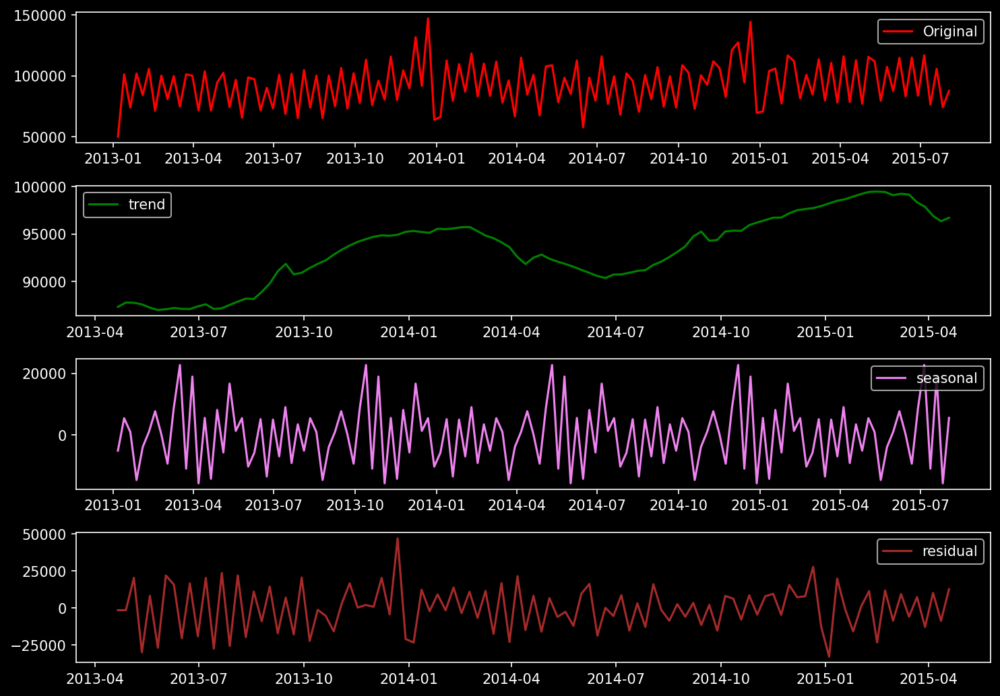

In [97]:
plot_seasonal_decomposition_results(sales_b_resampled,period=30)
# PERIOD --> 24(DAILY--if we have hour wise data),7(WEEKLY-if we have day wise data),
# 30(MONTHLY-if we have day wise data),12(YEARLY--if we have month wise data)

## ARIMA Model - Auto-Regressive Integrated Moving Average Model

### plot Auto-Correlation function & plot Partial-Auto-Correlation function
* Auto Correlation function (ACF) is a statistical tool used to measure the correlation between a time series and its lagged values (also known as autocorrelations).
* ACF plot is a graphical representation of the correlation coefficients at different lag values. It can be used to determine the optimal lag value for building autoregressive (AR) models and to understand the potential relationships between a time series and its past values.

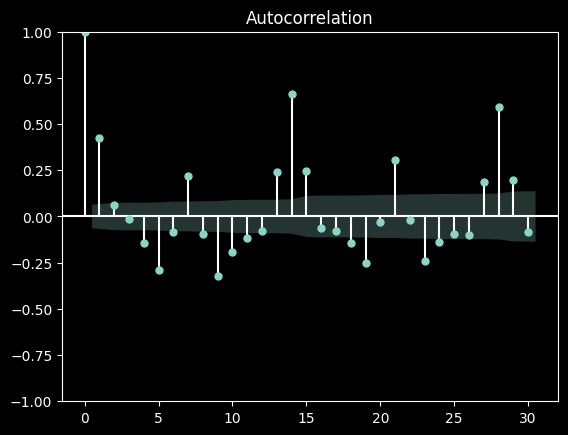

In [98]:
acf_a = plot_acf(sales_b)

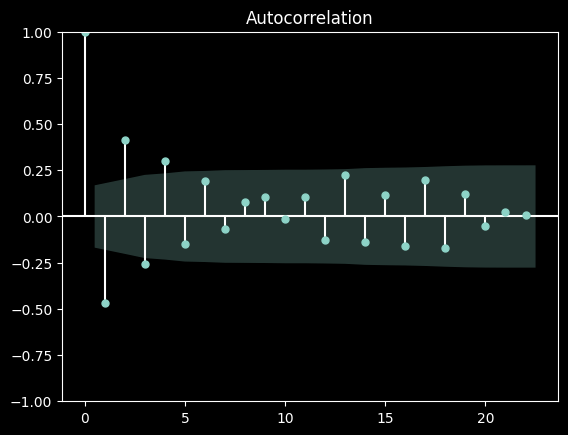

In [99]:
acf_a = plot_acf(sales_b_resampled)

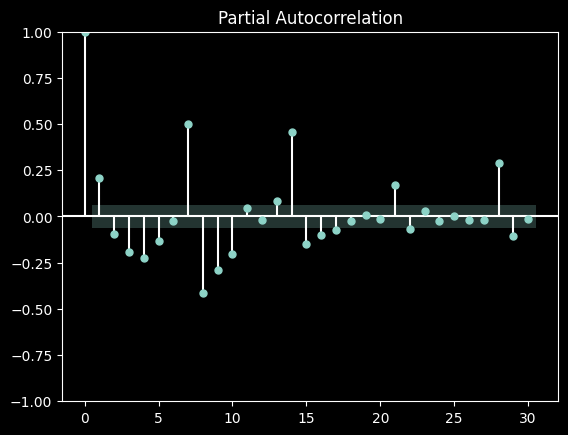

In [100]:
pacf_a = plot_pacf(sales_a,method='ywm')

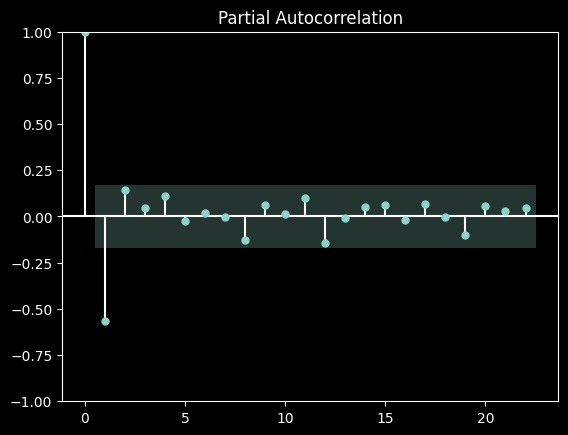

In [101]:
pacf_a = plot_pacf(sales_a_resampled,method='ywm')

**Resampling whole Dataset**

In [104]:
resampled_df = df.resample('W',on='Date').mean()

/var/folders/yz/rd_p5r694wz4_q5mc3q3wns40000gn/T/ipykernel_746/1889265380.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



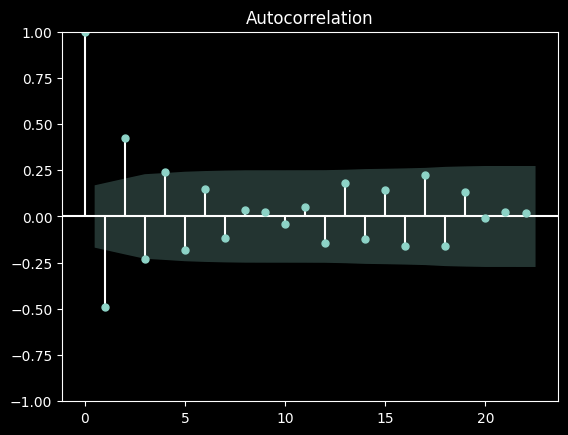

In [103]:
acf_df = plot_acf(resampled_df['Sales'])

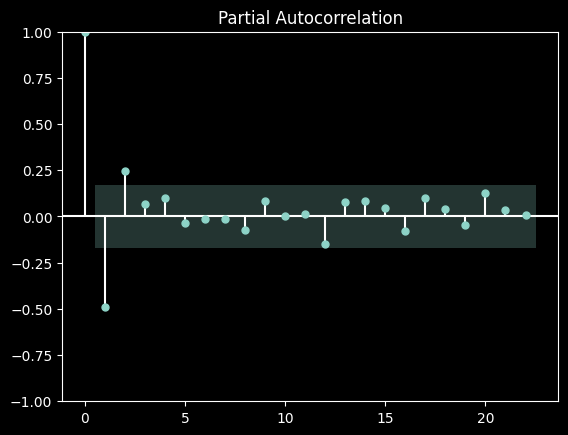

In [104]:
pacf_df = plot_pacf(resampled_df['Sales'],method='ywm')

### **Auto-Correlation plot**

<Axes: xlabel='Lag', ylabel='Autocorrelation'>

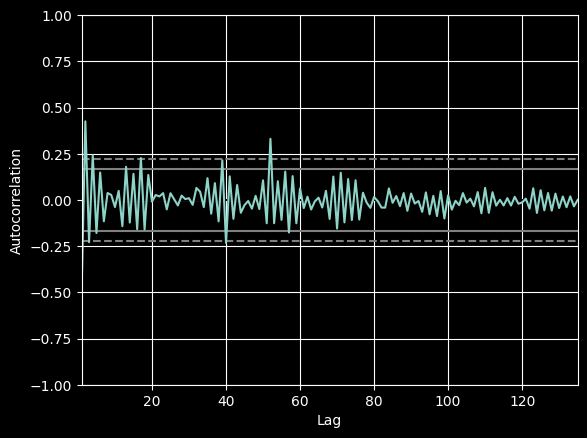

In [105]:
autocorrelation_plot(resampled_df['Sales'])

## **ARIMA**

In [106]:
arima_model = ARIMA(resampled_df['Sales'],order=(2,1,2))
arima_model_fit = arima_model.fit()

/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



In [107]:
arima_model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                  Sales   No. Observations:                  135
Model:                 ARIMA(2, 1, 2)   Log Likelihood               -1109.483
Date:                Fri, 25 Aug 2023   AIC                           2228.966
Time:                        02:19:21   BIC                           2243.455
Sample:                    01-06-2013   HQIC                          2234.854
                         - 08-02-2015                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.5226      0.262     -5.820      0.000      -2.035      -1.010
ar.L2         -0.5228      0.183     -2.857      0.004      -0.882      -0.164
ma.L1          0.0867      0.291      0.298      0.766      -0.484       0.657
ma.L2         -0.9113      0.261     -3.497      0.000      -1.422      -0.401
sigma2      8.279e+05   2.15e-06   3.84e+11      0.000    8.28e+05    8.28e+05
===================================================================================
Ljung-Box (L1) (Q):                   1.29   Jarque-Bera (JB):                57.43
Prob(Q):                              0.26   Prob(JB):                         0.00
Heteroskedasticity (H):               1.53   Skew:                             0.92
Prob(H) (two-sided):                  0.16   Kurtosis:                         5.63
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 3.48e+26. Standard errors may be unstable.
"""

In [108]:
arima_forecasted_results = arima_model_fit.forecast(steps = 40)
# arima_forecasted_results

In [109]:
test_date_range = pd.date_range(start='2015-08-09',periods=40,freq='W')
# test_date_range

In [110]:
arima_forecasted_df = arima_forecasted_results.to_frame(name='ARIMA Predictions')
# arima_forecasted_df

<Axes: >

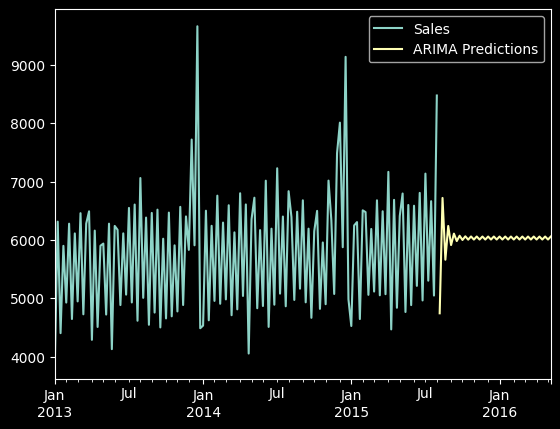

In [111]:
pd.concat([resampled_df['Sales'],arima_forecasted_df],axis=1).plot() # iplot()

**Inference:**
* ARIMA Model is not able to capture the pattern much better.

## **Auto-Arima --> Getting best Parameters for ARIMA**

In [112]:
stepwise_model = auto_arima(resampled_df['Sales'], start_p=1, start_q=1,
                           max_p=3, max_q=3, m=12,
                           start_P=0, seasonal=True,
                           d=1, D=1, trace=True,
                           error_action='ignore',
                           suppress_warnings=True,
                           stepwise=True)

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=0.55 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=2281.292, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=2122.697, Time=0.22 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.30 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=2156.254, Time=0.07 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=2101.716, Time=0.59 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=1.13 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.29 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=2227.705, Time=0.13 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=2093.179, Time=0.76 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=2110.052, Time=0.27 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=1.39 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=0.56 sec
 ARIMA(3,1,0)(2,1,0)[12]             : AIC=2084.463, Time=0.77 sec
 ARIMA(3,1,0)(1,1,0)[12]             : AIC=2101.6

In [113]:
forecasted_results = stepwise_model.predict(n_periods=40)

In [114]:
auto_arima_forecasted_df = pd.DataFrame(forecasted_results, index=test_date_range,columns=['predictions'])

In [115]:
# auto_arima_forecasted_df

<Axes: >

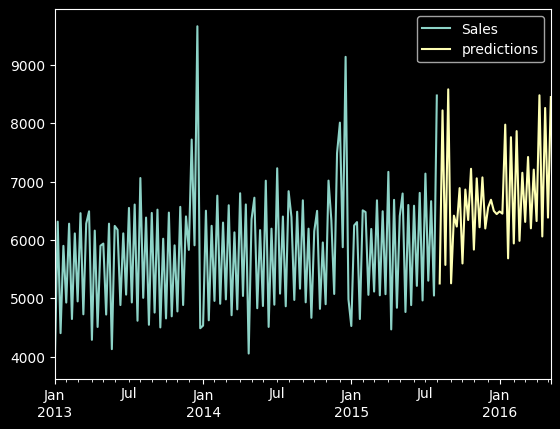

In [116]:
pd.concat([resampled_df['Sales'],auto_arima_forecasted_df],axis=1).plot() # iplot()

**Inference:**
* AUTO-ARIMA is somewhat able to capture the patterns of our data.

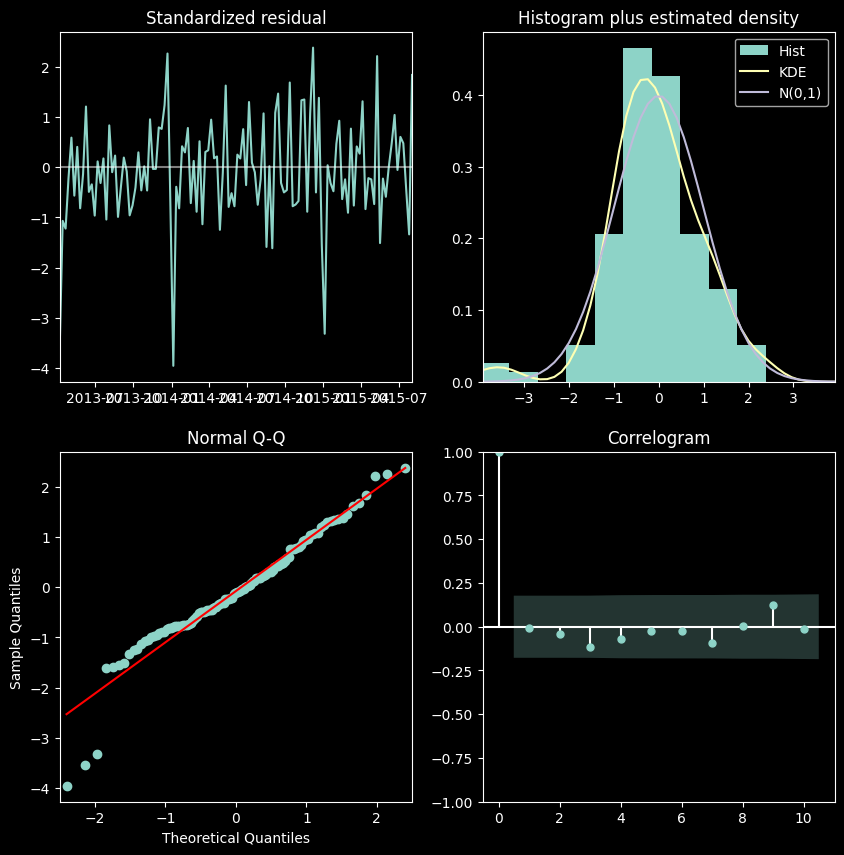

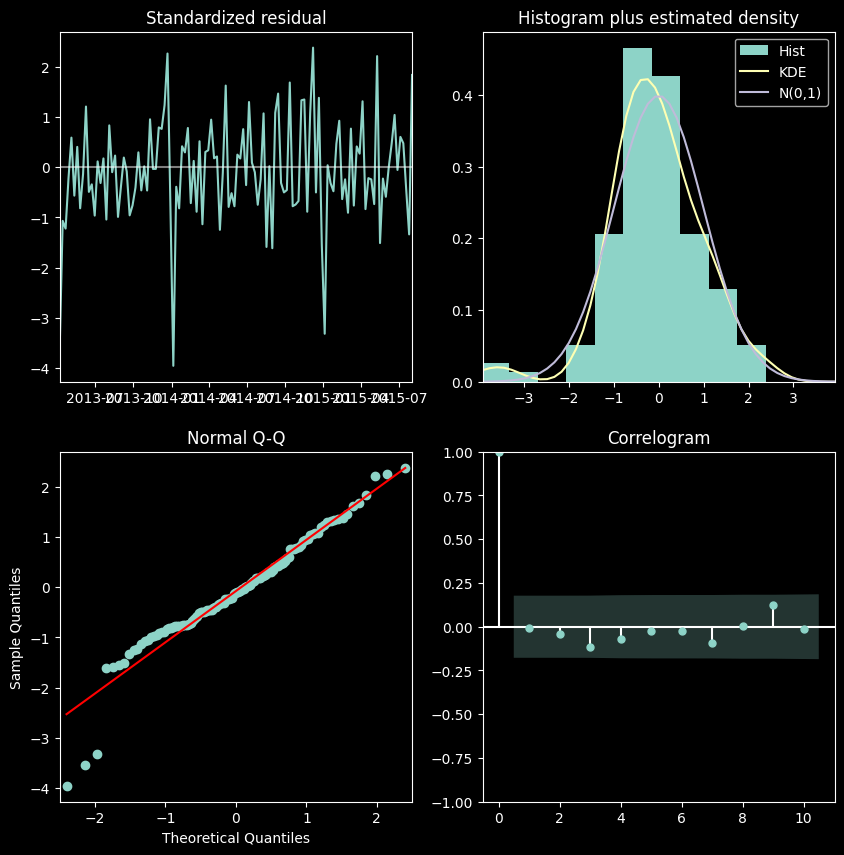

In [117]:
diagnostics_plots = stepwise_model.plot_diagnostics(figsize=(10, 10),dpi=150)

## **SARIMAX - Seasonal Auto-Regressive Integrated Moving Average with eXogenous factors**

In [118]:
sarimax_model = SARIMAX(resampled_df['Sales'],order=(3, 1, 0),seasonal_order=(0,1,1,7))
sarimax_model_fit = sarimax_model.fit()

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  7.95869D+00    |proj g|=  3.99330D-02

At iterate    5    f=  7.95475D+00    |proj g|=  1.97090D-02

At iterate   10    f=  7.95382D+00    |proj g|=  4.76226D-04

At iterate   15    f=  7.95371D+00    |proj g|=  5.57017D-03

At iterate   20    f=  7.92321D+00    |proj g|=  7.43210D-02

At iterate   25    f=  7.85673D+00    |proj g|=  6.95855D-03

At iterate   30    f=  7.85583D+00    |proj g|=  1.05471D-02

At iterate   35    f=  7.85489D+00    |proj g|=  1.25262D-03

At iterate   40    f=  7.85481D+00    |proj g|=  4.30350D-04

At iterate   45    f=  7.85480D+00    |proj g|=  3.10112D-04

At iterate   50    f=  7.85480D+00    |proj g|=  4.93856D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



<Axes: >

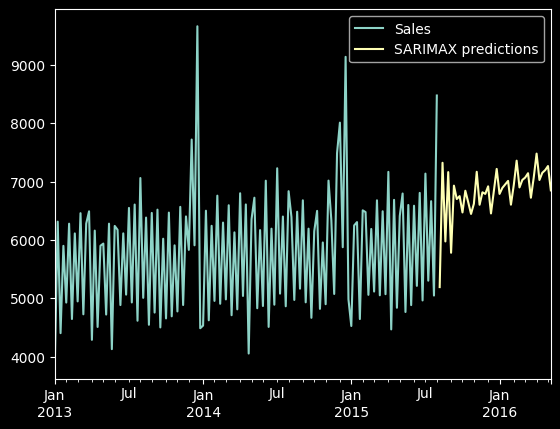

In [119]:
sarimax_model_results = sarimax_model_fit.forecast(steps=40)
sarimax_forecasted_df = sarimax_model_results.to_frame(name='SARIMAX predictions')
pd.concat([resampled_df['Sales'],sarimax_forecasted_df],axis=1).plot() # iplot()

#### **Grid Sreach for SARIMAX**

In [122]:
# Define parameter ranges
p_values = range(0, 3)  # Example range for P
d_values = range(1, 2)  # Example range for D
q_values = range(0, 3)  # Example range for Q
s = 7  # Weekly seasonality

# Grid search
best_aic = float("inf")
best_order = None

for p, d, q in itertools.product(p_values, d_values, q_values):
    try:
        model = sm.tsa.SARIMAX(resampled_df['Sales'], order=(p, d, q), seasonal_order=(0, 1, 1, s))
        results = model.fit()
        if results.aic < best_aic:
            best_aic = results.aic
            best_order = (p, d, q)
    except:
        continue

print("Best SARIMA Order:", best_order)


Best SARIMA Order: None


In [123]:
model_fit = model.fit()

NameError: name 'model' is not defined

In [ ]:
sarimax_model_results = model_fit.forecast(steps=40)

In [ ]:
sarimax_forecasted_df = sarimax_model_results.to_frame(name='SARIMAX predictions')

In [ ]:
pd.concat([resampled_df['Sales'],sarimax_forecasted_df],axis=1).plot() # iplot()

## **Facebook Prophet**

In [105]:
fb_prophet_model = Prophet()
fb_prophet_model.fit(resampled_df['Sales'].to_frame(name='y').reset_index().rename(columns={'Date':'ds'}))
# resampled_df['Sales'].to_frame(name='y').reset_index().rename(columns={'Date':'ds'})

11:40:24 - cmdstanpy - INFO - Chain [1] start processing
11:40:24 - cmdstanpy - INFO - Chain [1] done processing


In [115]:
future_data = fb_prophet_model.make_future_dataframe(periods=40,freq='W')

In [116]:
# future_data

,ds
0,2013-01-06
1,2013-01-13
2,2013-01-20
3,2013-01-27
4,2013-02-03
...,...
170,2016-04-10
171,2016-04-17
172,2016-04-24
173,2016-05-01


In [127]:
# test_date_range.to_frame().reset_index().drop(columns=0).rename(columns={'index':'ds'})

In [132]:
# fb_prophet_model_results = fb_prophet_model.predict(
#    test_date_range.to_frame().reset_index().drop(columns=0).rename(columns={'index':'ds'})
# )

In [131]:
'''plot = fb_prophet_model.plot(
fb_prophet_model_results[['ds','yhat','yhat_lower','yhat_upper']]
)'''

"plot = fb_prophet_model.plot(\nfb_prophet_model_results[['ds','yhat','yhat_lower','yhat_upper']]\n)"

In [133]:
# fb_prophet_components = fb_prophet_model.plot_components(fb_prophet_model_results)

In [119]:
fb_prophet_model_results = fb_prophet_model.predict(future_data)

In [111]:
fb_prophet_model_results.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2015-08-09,6059.045526,5039.800622,7590.589919,6059.045526,6059.045526,261.602326,261.602326,261.602326,261.602326,261.602326,261.602326,0.0,0.0,0.0,6320.647852
1,2015-08-16,6062.700373,5053.460688,7419.295857,6062.694784,6062.705997,155.252218,155.252218,155.252218,155.252218,155.252218,155.252218,0.0,0.0,0.0,6217.952591
2,2015-08-23,6066.355221,4908.027238,7319.978011,6066.340211,6066.369151,42.528826,42.528826,42.528826,42.528826,42.528826,42.528826,0.0,0.0,0.0,6108.884047
3,2015-08-30,6070.010068,4855.247547,7193.940186,6069.980196,6070.035003,-90.115941,-90.115941,-90.115941,-90.115941,-90.115941,-90.115941,0.0,0.0,0.0,5979.894127
4,2015-09-06,6073.664916,4741.199753,7159.828382,6073.619327,6073.706290,-220.369012,-220.369012,-220.369012,-220.369012,-220.369012,-220.369012,0.0,0.0,0.0,5853.295904


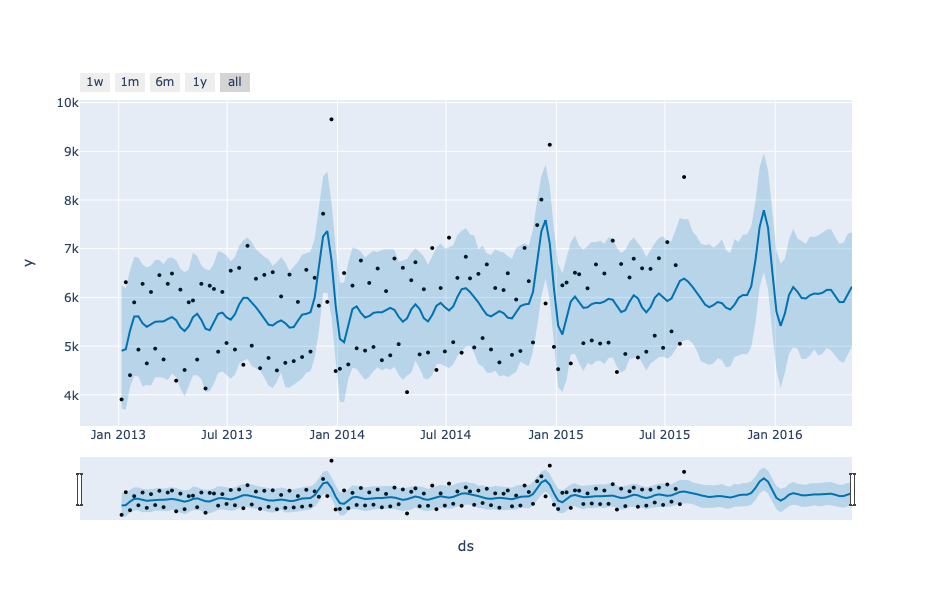

In [120]:
forecast_plots = plot_plotly(fb_prophet_model,fb_prophet_model_results)
plots.show()

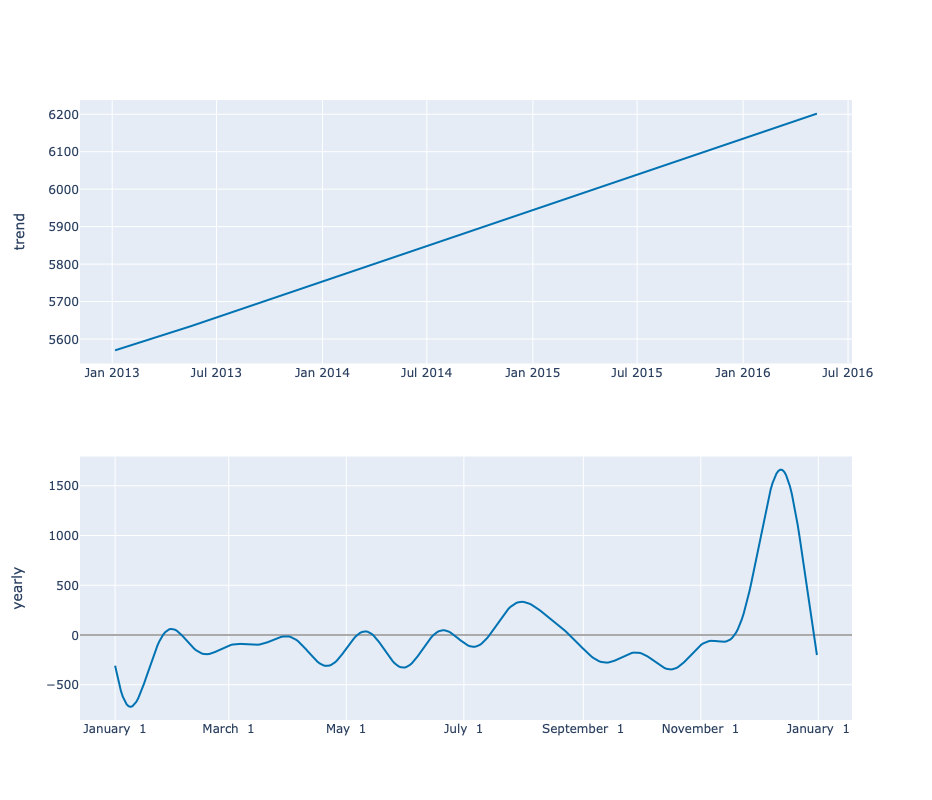

In [139]:
components_plots = plot_components_plotly(fb_prophet_model,fb_prophet_model_results,
                                         figsize=(1000,400))
components_plots.show()

In [153]:
# plot_forecast_component_plotly(fb_prophet_model,fb_prophet_model_results,
#                               figsize=(1000,400),name='daily')

In [152]:
# plot_seasonality_plotly(fb_prophet_model,
#                        figsize=(1000,400),name='weekly')

* For above model,,we passed Weekly data,,so for that there will bo no,weekly,daily components

## **Prophet Cross-Validation**
https://facebook.github.io/prophet/docs/diagnostics.html

In [156]:
initial = "365 days"  
period = "180 days"   
horizon = "90 days"   

cutoffs = pd.to_datetime(['2014-05-09', '2014-11-05', '2015-05-04'])

cv_df1 = cross_validation(fb_prophet_model, 
                 horizon=horizon,initial=initial,period=period,cutoffs=cutoffs)
cv_df1

Seasonality has period of 365.25 days which is larger than initial window. Consider increasing initial.


  0%|          | 0/3 [00:00<?, ?it/s]

12:21:13 - cmdstanpy - INFO - Chain [1] start processing
12:21:14 - cmdstanpy - INFO - Chain [1] done processing
12:21:14 - cmdstanpy - INFO - Chain [1] start processing
12:21:14 - cmdstanpy - INFO - Chain [1] done processing
12:21:14 - cmdstanpy - INFO - Chain [1] start processing
12:21:14 - cmdstanpy - INFO - Chain [1] done processing


,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2014-05-11,5749.423765,4428.371654,7011.747944,6722.966816,2014-05-09
1,2014-05-18,5674.905206,4514.690222,6901.315293,4831.357719,2014-05-09
2,2014-05-25,5564.251048,4386.523658,6772.556810,6168.539526,2014-05-09
3,2014-06-01,5604.944854,4378.258549,6818.229143,4869.232415,2014-05-09
4,2014-06-08,5803.846552,4631.251653,6937.294472,7014.123382,2014-05-09
5,2014-06-15,5968.124764,4776.416929,7130.168437,4511.595772,2014-05-09
6,2014-06-22,5939.830696,4805.583908,7111.179171,6192.738245,2014-05-09
7,2014-06-29,5790.920051,4497.605589,6981.410760,4891.892249,2014-05-09
8,2014-07-06,5734.572738,4535.495652,6862.280623,7226.651896,2014-05-09
9,2014-07-13,5865.450137,4722.526460,7037.095105,5081.306341,2014-05-09


**Inference:**
* From index 0 to 12,,see that date range is 2014-05-11 to 2014-08-03,,,which is roughly 90 days.

#### **Performance Metrics of Cross Validation**

In [163]:
performance_metrics(cv_df1).head()

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,3 days,6.287282e+07,7929.238139,6791.162964,1.256112,1.61641,1.059276,0.333333
1,8 days,6.254215e+07,7908.359625,6553.879346,1.202656,1.61641,1.013247,0.333333
2,9 days,4.011018e+07,6333.260041,4789.373451,0.759172,0.60698,0.975697,0.333333
3,10 days,2.024934e+08,14230.019005,9471.496627,2.006072,0.60698,0.975697,0.333333
4,15 days,2.027795e+08,14240.065772,9686.898561,2.054063,0.60698,1.017235,0.333333


In [171]:
pd.options.plotting.backend = "plotly"

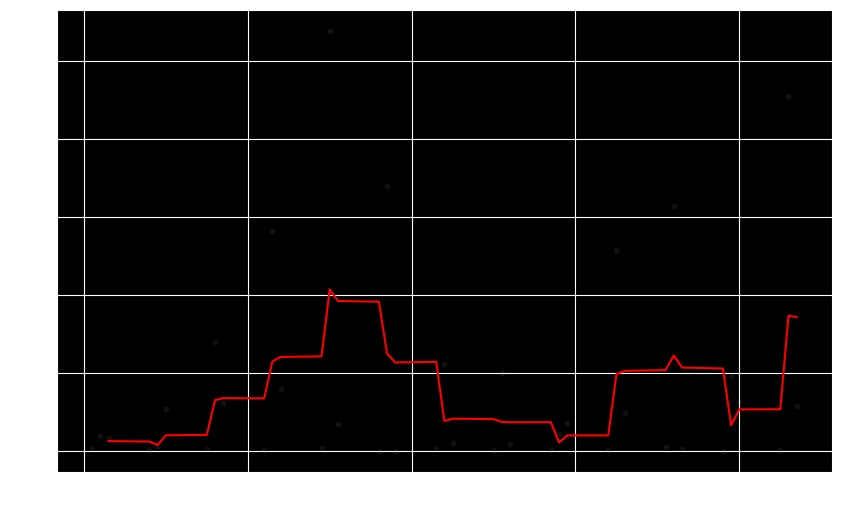

In [178]:
plot = plot_cross_validation_metric(cv_df,metric='mape',color='red')

#### **Applying Prophet Model for a particular store**

In [123]:
df[df['Store']==31]['Date']

30        2015-07-31
1145      2015-07-30
2260      2015-07-29
3375      2015-07-28
4490      2015-07-27
             ...    
1011665   2013-01-05
1012780   2013-01-04
1013895   2013-01-03
1015010   2013-01-02
1016125   2013-01-01
Name: Date, Length: 942, dtype: datetime64[ns]

In [179]:
def prophet_sales_prediction(store_id,sales_data,periods):
    
    sales_data = sales_data[sales_data['Store']==store_id]
    sales_data = sales_data[['Date','Sales']].rename(columns={'Date':'ds',"Sales":'y'})
    sales_data = sales_data.sort_values(by='ds')

    model = Prophet()
    model.fit(sales_data)
    future = model.make_future_dataframe(periods = periods,freq='d')
    forecast = model.predict(future)
    
    forecast_plot = plot_plotly(model,forecast)
    forecast_plot.show()
    components_plots = plot_components_plotly(model,forecast,
                                         figsize=(1000,400))
    components_plots.show()

    return sales_data , forecast

12:47:58 - cmdstanpy - INFO - Chain [1] start processing
12:47:58 - cmdstanpy - INFO - Chain [1] done processing


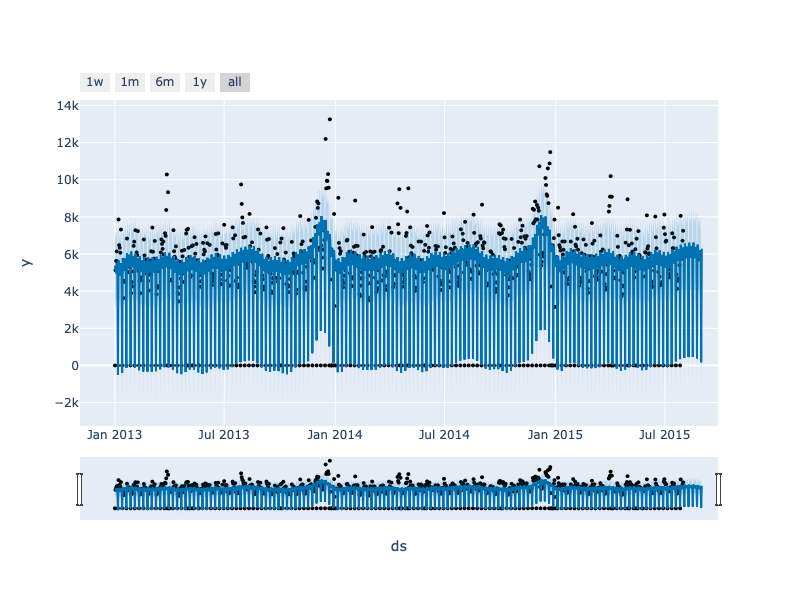

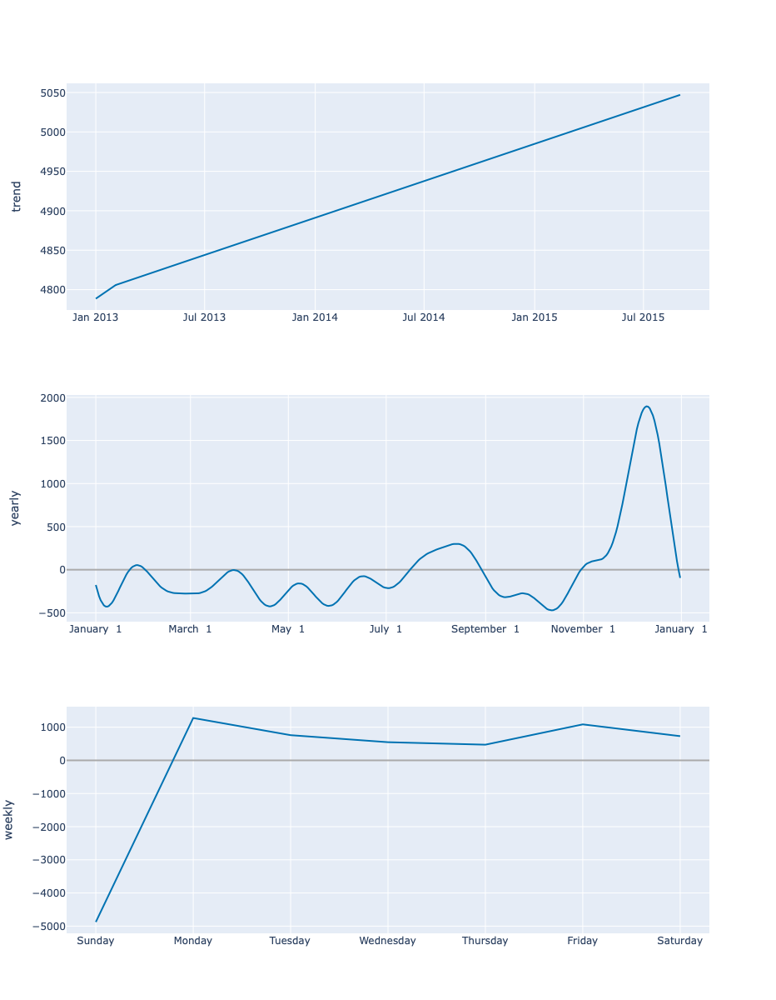

In [184]:
data,forecast = prophet_sales_prediction(store_id=31,sales_data=df,periods=31)

#### **School Hoildays**

In [69]:
# GETTING DATES ON WHICH THERE WAS A HOLIDAY

school_holidays_dates = df[df['SchoolHoliday'] == 1]['Date'].dt.date

In [71]:
school_holidays_dates

0          2015-07-31
1          2015-07-31
2          2015-07-31
3          2015-07-31
4          2015-07-31
              ...    
1017204    2013-01-01
1017205    2013-01-01
1017206    2013-01-01
1017207    2013-01-01
1017208    2013-01-01
Name: Date, Length: 181721, dtype: object

In [55]:
len(school_holidays_dates) , len(np.unique(school_holidays_dates))

(181721, 478)

In [72]:
# np.unique(school_holidays_dates)

array([datetime.date(2013, 1, 1), datetime.date(2013, 1, 2),
       datetime.date(2013, 1, 3), datetime.date(2013, 1, 4),
       datetime.date(2013, 1, 5), datetime.date(2013, 1, 6),
       datetime.date(2013, 1, 7), datetime.date(2013, 1, 8),
       datetime.date(2013, 1, 9), datetime.date(2013, 1, 10),
       datetime.date(2013, 1, 11), datetime.date(2013, 1, 31),
       datetime.date(2013, 2, 1), datetime.date(2013, 2, 4),
       datetime.date(2013, 2, 5), datetime.date(2013, 2, 6),
       datetime.date(2013, 2, 7), datetime.date(2013, 2, 8),
       datetime.date(2013, 2, 11), datetime.date(2013, 2, 12),
       datetime.date(2013, 2, 13), datetime.date(2013, 2, 14),
       datetime.date(2013, 2, 15), datetime.date(2013, 2, 18),
       datetime.date(2013, 2, 19), datetime.date(2013, 2, 20),
       datetime.date(2013, 2, 21), datetime.date(2013, 2, 22),
       datetime.date(2013, 3, 4), datetime.date(2013, 3, 5),
       datetime.date(2013, 3, 6), datetime.date(2013, 3, 7),
       date

In [81]:
school_holidays_dates_df = pd.DataFrame(data={'ds':np.unique(school_holidays_dates),
                                       'holiday':'school_holiday'})

In [82]:
# school_holidays_dates_df

,ds,holiday
0,2013-01-01,school_holiday
1,2013-01-02,school_holiday
2,2013-01-03,school_holiday
3,2013-01-04,school_holiday
4,2013-01-05,school_holiday
...,...,...
473,2015-07-27,school_holiday
474,2015-07-28,school_holiday
475,2015-07-29,school_holiday
476,2015-07-30,school_holiday


#### **State Holidays**

In [56]:
df.StateHoliday.value_counts()

0    855087
0    131072
a     20260
b      6690
c      4100
Name: StateHoliday, dtype: int64

In [73]:
state_holidays_dates = df[df['StateHoliday'].isin(['a','b','c'])]['Date'].dt.date

In [74]:
# state_holidays_dates

63555      2015-06-04
63557      2015-06-04
63559      2015-06-04
63560      2015-06-04
63563      2015-06-04
              ...    
1017204    2013-01-01
1017205    2013-01-01
1017206    2013-01-01
1017207    2013-01-01
1017208    2013-01-01
Name: Date, Length: 31050, dtype: object

In [66]:
len(state_holidays_dates) , len(np.unique(state_holidays_dates))

(31050, 37)

In [75]:
np.unique(state_holidays_dates)

array([datetime.date(2013, 1, 1), datetime.date(2013, 1, 6),
       datetime.date(2013, 3, 29), datetime.date(2013, 4, 1),
       datetime.date(2013, 5, 1), datetime.date(2013, 5, 9),
       datetime.date(2013, 5, 20), datetime.date(2013, 5, 30),
       datetime.date(2013, 8, 15), datetime.date(2013, 10, 3),
       datetime.date(2013, 10, 31), datetime.date(2013, 11, 1),
       datetime.date(2013, 11, 20), datetime.date(2013, 12, 25),
       datetime.date(2013, 12, 26), datetime.date(2014, 1, 1),
       datetime.date(2014, 1, 6), datetime.date(2014, 4, 18),
       datetime.date(2014, 4, 21), datetime.date(2014, 5, 1),
       datetime.date(2014, 5, 29), datetime.date(2014, 6, 9),
       datetime.date(2014, 6, 19), datetime.date(2014, 10, 3),
       datetime.date(2014, 10, 31), datetime.date(2014, 11, 1),
       datetime.date(2014, 11, 19), datetime.date(2014, 12, 25),
       datetime.date(2014, 12, 26), datetime.date(2015, 1, 1),
       datetime.date(2015, 1, 6), datetime.date(2015, 4, 

In [83]:
state_holidays_dates_df = pd.DataFrame(data={'ds':np.unique(state_holidays_dates),
                                       'holiday':'state_holiday'})

In [84]:
# state_holidays_dates_df

,ds,holiday
0,2013-01-01,state_holiday
1,2013-01-06,state_holiday
2,2013-03-29,state_holiday
3,2013-04-01,state_holiday
4,2013-05-01,state_holiday
5,2013-05-09,state_holiday
6,2013-05-20,state_holiday
7,2013-05-30,state_holiday
8,2013-08-15,state_holiday
9,2013-10-03,state_holiday


**Combining those School Hoildays and State Holidays**

In [91]:
all_holidays_df = pd.concat([school_holidays_dates_df,state_holidays_dates_df])
all_holidays_df

,ds,holiday
0,2013-01-01,school_holiday
1,2013-01-02,school_holiday
2,2013-01-03,school_holiday
3,2013-01-04,school_holiday
4,2013-01-05,school_holiday
...,...,...
32,2015-04-06,state_holiday
33,2015-05-01,state_holiday
34,2015-05-14,state_holiday
35,2015-05-25,state_holiday


#### **Including Holidays in Prophet Model**

In [185]:
def sales_prediction(store_id, sales_data, holidays, periods):
  
    sales_data = sales_data[sales_data['Store'] == store_id]
    sales_data = sales_data[['Date', 'Sales']].rename(columns = {'Date': 'ds', 'Sales': 'y'})
    sales_data = sales_data.sort_values(by = 'ds')
    
    model = Prophet(holidays=holidays)
    model.fit(sales_data)
    future = model.make_future_dataframe(periods = periods)
    forecast = model.predict(future)
    
    forecast_plot = plot_plotly(model,forecast)
    forecast_plot.show()
    components_plots = plot_components_plotly(model,forecast,
                                         figsize=(1000,400))
    components_plots.show()

    cv_df = cross_validation(model, 
                 horizon=horizon,initial=initial,period=period,cutoffs=cutoffs)

    return sales_data , forecast , cv_df

12:49:55 - cmdstanpy - INFO - Chain [1] start processing
12:49:55 - cmdstanpy - INFO - Chain [1] done processing


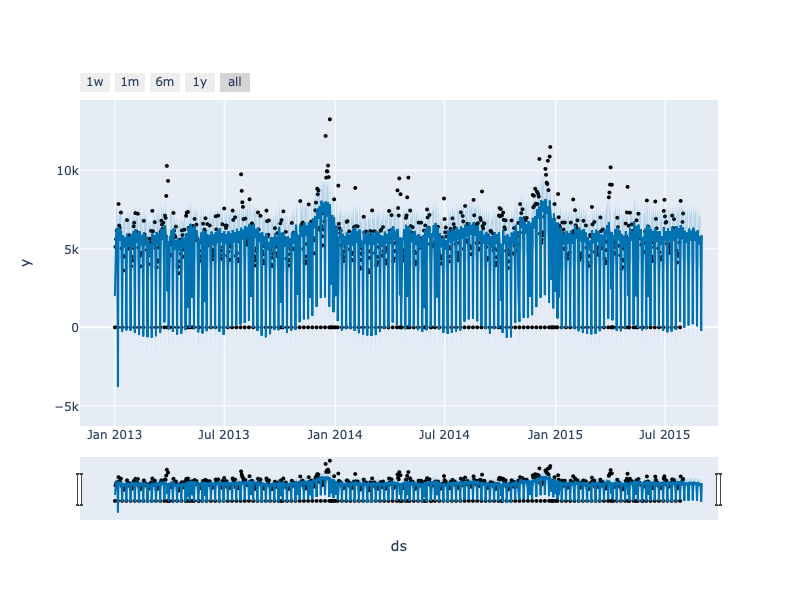

/opt/anaconda3/lib/python3.9/site-packages/prophet/plot.py:870: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



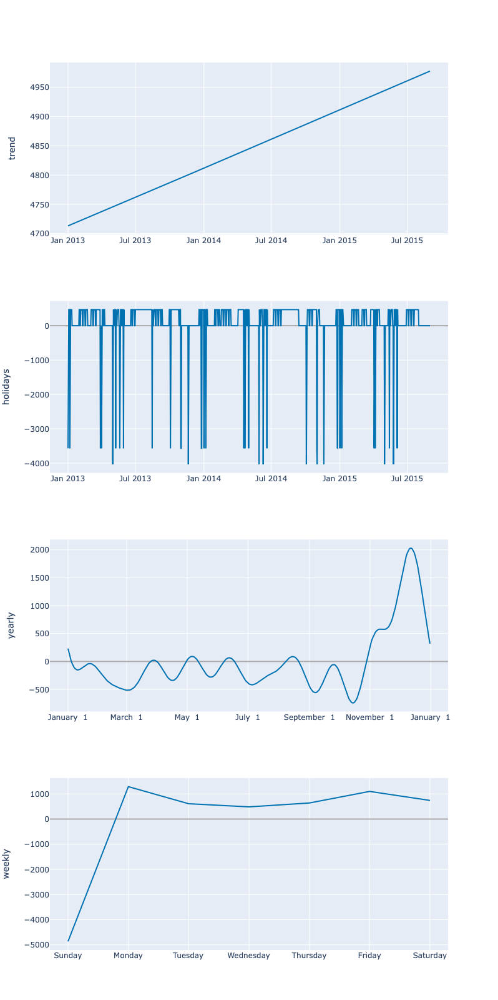

Seasonality has period of 365.25 days which is larger than initial window. Consider increasing initial.


  0%|          | 0/3 [00:00<?, ?it/s]

12:49:56 - cmdstanpy - INFO - Chain [1] start processing
12:49:56 - cmdstanpy - INFO - Chain [1] done processing
12:49:57 - cmdstanpy - INFO - Chain [1] start processing
12:49:57 - cmdstanpy - INFO - Chain [1] done processing
12:49:57 - cmdstanpy - INFO - Chain [1] start processing
12:49:57 - cmdstanpy - INFO - Chain [1] done processing


In [186]:
data,forecast,cv_df2 = sales_prediction(store_id=31,sales_data=df,holidays=all_holidays_df,periods=31)

In [187]:
performance_metrics(cv_df2).head()

,horizon,mse,rmse,mae,mdape,smape,coverage
0,9 days,5.986359e+06,2446.703802,1913.294084,0.430481,0.624547,0.481481
1,10 days,1.077882e+07,3283.111004,2334.604563,0.574860,0.656476,0.407407
2,11 days,1.955935e+07,4422.595519,2814.441492,0.574860,0.627639,0.407407
3,12 days,3.497817e+07,5914.234825,3475.577598,0.574860,0.593368,0.407407
4,13 days,5.983133e+07,7735.071680,4302.764837,0.574860,0.617782,0.407407


# Machine Learning Modelling

### Feature Preprocessing
#### **Binary feature encoding**

In [30]:
df.select_dtypes(include='object').sample(5)

,StateHoliday,StoreType,Assortment,PromoInterval
74150,0,d,a,0
951840,0,a,c,0
299442,0,d,c,0
861559,a,c,a,"Mar,Jun,Sept,Dec"
957120,0,a,a,"Mar,Jun,Sept,Dec"


In [31]:
df.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval', 'Year', 'Month', 'Day',
       'WeekOfYear', 'SalesPerCustomer'],
      dtype='object')

In [32]:
# GETTING CONTINOUS AND CATEGORICAL COLUMNS NAMES

categorical_columns = df.select_dtypes(include=['object']).columns.tolist()
continuous_columns = df.select_dtypes(include=['number']).columns.tolist()

# BINARY ENCODING
encoder = ce.BinaryEncoder(cols=categorical_columns)
encoder_fit = encoder.fit_transform(df[categorical_columns])

# Combine DataFrames

encoded_df = pd.concat([df[continuous_columns], encoder_fit], axis=1)

In [33]:
encoded_df

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,Year,Month,Day,WeekOfYear,SalesPerCustomer,StateHoliday_0,StateHoliday_1,StateHoliday_2,StoreType_0,StoreType_1,StoreType_2,Assortment_0,Assortment_1,PromoInterval_0,PromoInterval_1,PromoInterval_2
0,1,5,5263,555,1,1,1,1270.0,9.0,2008.0,0,0.0,0.0,2015,7,31,31,9.482883,0,0,1,0,0,1,0,1,0,0,1
1,2,5,6064,625,1,1,1,570.0,11.0,2007.0,1,13.0,2010.0,2015,7,31,31,9.702400,0,0,1,0,1,0,0,1,0,1,0
2,3,5,8314,821,1,1,1,14130.0,12.0,2006.0,1,14.0,2011.0,2015,7,31,31,10.126675,0,0,1,0,1,0,0,1,0,1,0
3,4,5,13995,1498,1,1,1,620.0,9.0,2009.0,0,0.0,0.0,2015,7,31,31,9.342457,0,0,1,0,0,1,1,0,0,0,1
4,5,5,4822,559,1,1,1,29910.0,4.0,2015.0,0,0.0,0.0,2015,7,31,31,8.626118,0,0,1,0,1,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017204,1111,2,0,0,0,0,1,1900.0,6.0,2014.0,1,31.0,2013.0,2013,1,1,1,NaN,0,1,0,0,1,0,0,1,0,1,0
1017205,1112,2,0,0,0,0,1,1880.0,4.0,2006.0,0,0.0,0.0,2013,1,1,1,NaN,0,1,0,0,0,1,1,0,0,0,1
1017206,1113,2,0,0,0,0,1,9260.0,0.0,0.0,0,0.0,0.0,2013,1,1,1,NaN,0,1,0,0,1,0,1,0,0,0,1
1017207,1114,2,0,0,0,0,1,870.0,0.0,0.0,0,0.0,0.0,2013,1,1,1,NaN,0,1,0,0,1,0,1,0,0,0,1


#### **Correlation Plot**

In [34]:
# !pip install klib

<Axes: title={'center': 'Feature-correlation (pearson)'}>

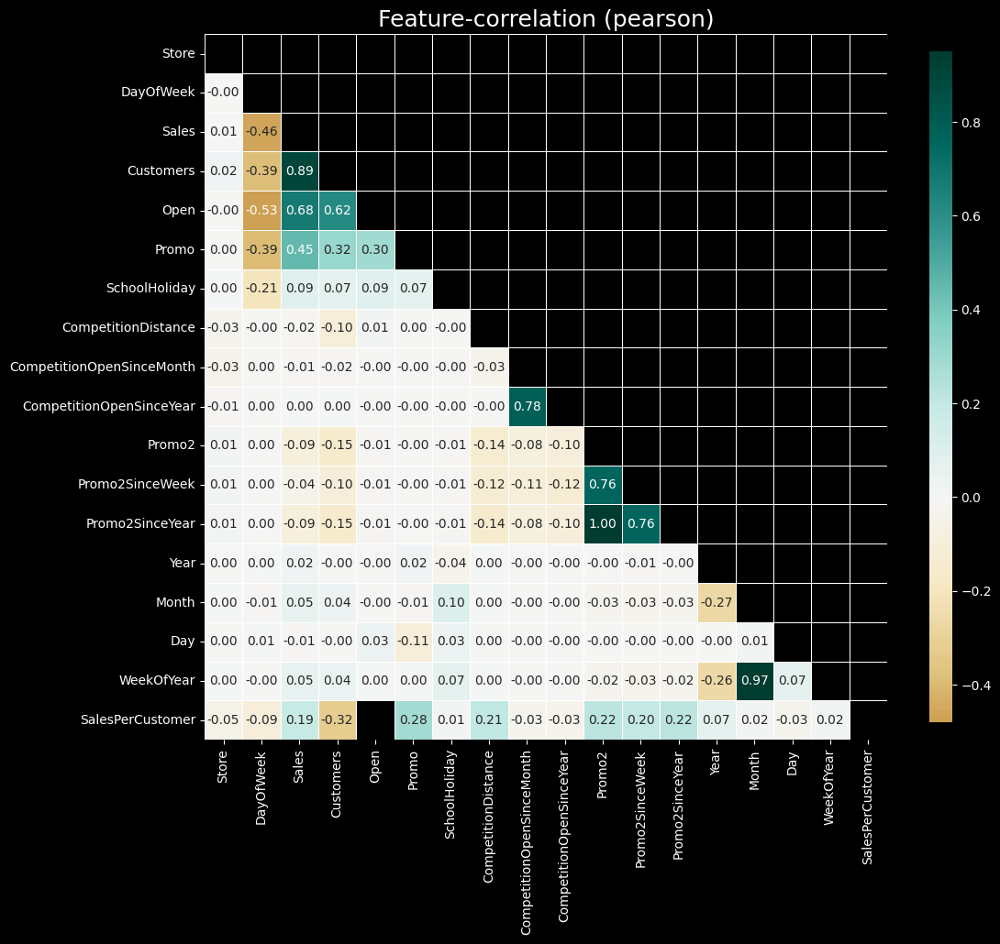

In [35]:
import klib
klib.corr_plot(df)

In [36]:
# FUNCTION TO CALCULATE VARIANCE INFLATION FACTOR

def calc_vif(X):
    vif = pd.DataFrame()
    vif['Variables'] = X.columns
    vif['VIF'] = [ variance_inflation_factor(X.values,i) 
                   for i in range(X.shape[1])
                 ]
    return vif

In [37]:
encoded_df.fillna(0,inplace=True)

In [38]:
calc_vif(encoded_df[[ i for i in encoded_df.columns
                      if i not in ['Sales']
                    ]])

/opt/anaconda3/lib/python3.9/site-packages/statsmodels/stats/outliers_influence.py:195: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


,Variables,VIF
0,Store,4.051681e+00
1,DayOfWeek,8.562859e+00
2,Customers,6.961091e+00
3,Open,4.944955e+01
4,Promo,2.354726e+00
5,SchoolHoliday,1.335731e+00
6,CompetitionDistance,1.672010e+00
7,CompetitionOpenSinceMonth,6.160973e+00
8,CompetitionOpenSinceYear,8.475719e+00
9,Promo2,inf


In [39]:
calc_vif(encoded_df[[ i for i in encoded_df.columns
                      if i not in ['Sales','Promo2']
                    ]])

,Variables,VIF
0,Store,4.051681e+00
1,DayOfWeek,8.562859e+00
2,Customers,6.961091e+00
3,Open,4.944955e+01
4,Promo,2.354726e+00
5,SchoolHoliday,1.335731e+00
6,CompetitionDistance,1.672010e+00
7,CompetitionOpenSinceMonth,6.160973e+00
8,CompetitionOpenSinceYear,8.475719e+00
9,Promo2SinceWeek,4.037422e+00


#### **Anlayzing Target Variable**

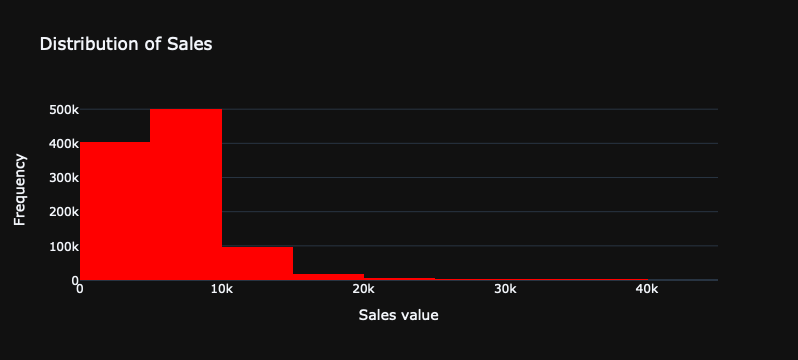

In [40]:
# HISTOGRAM USING PLOTLY

histogram_trace = go.Histogram(x=encoded_df['Sales'],nbinsx=10,marker=dict(color='red'))

layout = go.Layout(                 # ADDING LAYOUT TO TRACE
    title = 'Distribution of Sales',
    xaxis = dict(title = 'Sales value'),
    yaxis = dict(title = 'Frequency')
)

fig = go.Figure(data=histogram_trace , layout=layout)
fig.update_layout(template='plotly_dark')

fig.show()

In [41]:
# CHECKING THOSE RECORDS WHERE SALES ARE ZERO DUE TO CLOSING

print('Records where sales are zero due to closing of stores : ',len(encoded_df.query('Sales == 0 and Open == 0')))

# DROPPING THOSE RECORDS

new_df = encoded_df.drop(index=encoded_df.query('Sales == 0 and Open == 0').index)

Records where sales are zero due to closing of stores :  172817


In [42]:
new_df.shape

(844392, 29)

## Modelling

In [43]:
X = new_df.drop(columns=['Sales'])
y = new_df['Sales']

In [44]:
# TRAIN - TEST SPLIT
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=31)
# SCALING
scaler = ()
scaled_X_train = scaler.fit_transform(X_train)
scaled_X_test = scaler.transform(X_test)

In [45]:
scaled_X_train.shape , scaled_X_test.shape , y_train.shape , y_test.shape

((633294, 28), (211098, 28), (633294,), (211098,))

In [46]:
linear_model = LinearRegression()
ridgecv_model = RidgeCV()
lassocv_model = LassoCV()
elasticnetcv_model = ElasticNetCV()

In [47]:
linear_model.fit(scaled_X_train,y_train)

LinearRegression()

In [48]:
linear_model.score(scaled_X_train,y_train)

0.940218988745446

In [49]:
linear_preds = linear_model.predict(scaled_X_test)

In [50]:
mse = mean_squared_error(y_test,linear_preds)
rmse = np.sqrt(mse)
rmpse = rmse / y.mean()
r2 = r2_score(y_test,linear_preds)

In [51]:
mse , rmse , rmpse , r2

(559408.7747353754, 747.9363440396351, 0.10753142223194921, 0.9416609998147156)

## **XGBoost Model**

In [81]:
xgb_regressor_model = XGBRegressor(n_estimators=31,
                                  n_jobs=-1,
                                  random_state=31,
                                  max_depth=5)
xgb_regressor_model.fit(scaled_X_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=5, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=31, n_jobs=-1, num_parallel_tree=None, predictor=None,
             random_state=31, ...)

In [82]:
xgb_regressor_preds = xgb_regressor_model.predict(scaled_X_test)

In [83]:
mse = mean_squared_error(y_test,xgb_regressor_preds)
rmse = np.sqrt(mse)
rmpse = rmse / y.mean()
r2 = r2_score(y_test,xgb_regressor_preds)

mse , rmse , rmpse , r2

(27397.972617542542,
 165.52332952651278,
 0.023797424979271096,
 0.9971427507007423)